In [ ]:
!git clone https://github.com/uvavision/AMC-grounding.git

Cloning into 'AMC-grounding'...
remote: Enumerating objects: 169, done.
remote: Counting objects: 100% (104/104), done.
remote: Compressing objects: 100% (88/88), done.
remote: Total 169 (delta 33), reused 61 (delta 12), pack-reused 65 (from 1)
Receiving objects: 100% (169/169), 11.77 MiB | 17.31 MiB/s, done.
Resolving deltas: 100% (49/49), done.


In [ ]:
%cd AMC-grounding

/content/AMC-grounding


In [ ]:
file_path = 'models/xbert.py'

with open(file_path, 'r') as f:
    lines = f.readlines()
new_lines = [line for line in lines if 'tokenizer_class=' not in line]
with open(file_path, 'w') as f:
    f.writelines(new_lines)

In [ ]:
  import os
  import numpy as np
  import random
  import json
  from pathlib import Path
  import re
  from functools import partial
  import torch
  import torch.nn as nn
  import torch.nn.functional as F

  from models.vit import interpolate_pos_embed, VisionTransformer
  from models.tokenization_bert import BertTokenizer
  from models.xbert import BertConfig, BertModel
  from models.model_eval import ALBEF

  from torchvision import transforms
  from PIL import Image
  from matplotlib import pyplot as plt
  import cv2
  from skimage import transform as skimage_transform
  from scipy.ndimage import filters
  import warnings
  warnings.filterwarnings('ignore')

/usr/local/lib/python3.11/dist-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/usr/local/lib/python3.11/dist-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


# Step 1: Load Model

In [ ]:
torch.__version__

'2.6.0+cu124'

In [ ]:
bert_config_path = 'configs/config_bert.json'

In [ ]:
def getAttMap(img, attMap, blur = True, overlap = True):
    attMap -= attMap.min()
    if attMap.max() > 0:
        attMap /= attMap.max()
    attMap = skimage_transform.resize(attMap, (img.shape[:2]), order = 3, mode = 'constant')
    if blur:
        attMap = filters.gaussian_filter(attMap, 0.02*max(img.shape[:2]))
        attMap -= attMap.min()
        attMap /= attMap.max()
    cmap = plt.get_cmap('jet')
    attMapV = cmap(attMap)
    attMapV = np.delete(attMapV, 3, 2)
    if overlap:
        attMap = 1*(1-attMap**0.7).reshape(attMap.shape + (1,))*img + (attMap**0.7).reshape(attMap.shape+(1,)) * attMapV
    return attMap


def pre_caption(caption,max_words=50):
    caption = re.sub(
        r"([,.'!?\"()*#:;~])",
        '',
        caption.lower(),
    ).replace('-', ' ').replace('/', ' ')

    caption = re.sub(
        r"\s{2,}",
        ' ',
        caption,
    )
    caption = caption.rstrip('\n')
    caption = caption.strip(' ')

    #truncate caption
    caption_words = caption.split(' ')
    if len(caption_words)>max_words:
        caption = ' '.join(caption_words[:max_words])
    return caption

"""
def get_phrase_gradcam(text, image, model):
    text_input = tokenizer(text, return_tensors="pt")
    image = image.cuda()
    text_input = text_input.to(image.device)
    output = model(image, text_input)"""

def get_phrase_gradcam(text, image, model, tokenizer):
    text_input = tokenizer(text, return_tensors="pt")

    if hasattr(image, 'pixel_values'):
        image = image.pixel_values

    image = image.cuda()
    text_input = text_input.to(image.device)

    output = model(image, text_input)
    loss = output[:,1].sum()
    model.zero_grad()
    loss.backward()

    with torch.no_grad():
        mask = text_input.attention_mask.view(text_input.attention_mask.size(0),1,-1,1,1)

        grads=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attn_gradients()
        cams=model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.get_attention_map()

        cams = cams[:, :, :, 1:].reshape(image.size(0), 12, -1, 16, 16) * mask
        grads = grads[:, :, :, 1:].clamp(0).reshape(image.size(0), 12, -1, 16, 16) * mask

        gradcam = cams * grads
        gradcam = gradcam.mean(1).mean(1)
    return gradcam


class VL_Transformer_ITM(nn.Module):
    def __init__(self,
                 text_encoder = None,
                 config_bert = ''
                 ):
        super().__init__()

        bert_config = BertConfig.from_json_file(config_bert)

        self.visual_encoder = VisionTransformer(
            img_size=256, patch_size=16, embed_dim=768, depth=12, num_heads=12,
            mlp_ratio=4, qkv_bias=True, norm_layer=partial(nn.LayerNorm, eps=1e-6))

        self.text_encoder = BertModel.from_pretrained(text_encoder, config=bert_config, add_pooling_layer=False)

        self.itm_head = nn.Linear(768, 2)


    def forward(self, image, text):
        image_embeds = self.visual_encoder(image)

        image_atts = torch.ones(image_embeds.size()[:-1],dtype=torch.long).to(image.device)

        output = self.text_encoder(text.input_ids,
                                attention_mask = text.attention_mask,
                                encoder_hidden_states = image_embeds,
                                encoder_attention_mask = image_atts,
                                return_dict = True,
                               )

        vl_embeddings = output.last_hidden_state[:,0,:]
        vl_output = self.itm_head(vl_embeddings)
        return vl_output

In [ ]:
file_path = 'models/xbert.py'
with open(file_path, 'r') as file:
    code = file.read()

code = code.replace('tokenizer.vocab', 'tokenizer.get_vocab()')

with open(file_path, 'w') as file:
    file.write(code)

In [ ]:
from transformers import BertTokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', use_fast=False)
model = VL_Transformer_ITM(text_encoder='bert-base-uncased', config_bert=bert_config_path)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

In [ ]:
import gdown

In [ ]:
output_base = '/content/AMC-grounding/best_models'
os.makedirs(output_base, exist_ok=True)

In [ ]:
destination='/content/AMC-grounding/best_models/best_refcoco.pth'
gdown.download(f'https://drive.google.com/uc?id=1FaTMaB2hSaDlk4fp5ahx-rKT5coE9ci4',destination)

Downloading...
From (original): https://drive.google.com/uc?id=1FaTMaB2hSaDlk4fp5ahx-rKT5coE9ci4
From (redirected): https://drive.google.com/uc?id=1FaTMaB2hSaDlk4fp5ahx-rKT5coE9ci4&confirm=t&uuid=943af2db-0ea7-4dad-9dfe-24818233a806
To: /content/AMC-grounding/best_models/best_refcoco.pth
100%|██████████| 1.81G/1.81G [00:27<00:00, 65.7MB/s]


'/content/AMC-grounding/best_models/best_refcoco.pth'

In [ ]:
model_path = 'best_models/best_refcoco.pth'
checkpoint = torch.load(model_path, map_location='cpu')

In [ ]:
print('load pretraining model.')
state_dict = checkpoint['model']
pos_embed_reshaped = interpolate_pos_embed(state_dict['visual_encoder.pos_embed'],model.visual_encoder)
state_dict['visual_encoder.pos_embed'] = pos_embed_reshaped

for key in list(state_dict.keys()):
    if 'bert' in key:
        encoder_key = key.replace('bert.','')
        state_dict[encoder_key] = state_dict[key]
        del state_dict[key]
msg = model.load_state_dict(state_dict,strict=False)
model = model.eval()
model = model.cuda()

load pretraining model.


In [ ]:
block_num = 8
model.text_encoder.base_model.base_model.encoder.layer[block_num].crossattention.self.save_attention = True

# 2. Load Image and Text

In [ ]:
normalize = transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))

transform = transforms.Compose([
    transforms.Resize((256,256),interpolation=Image.BICUBIC),
    transforms.ToTensor(),
    normalize,
])

In [ ]:
output_base = '/content/AMC-grounding/test_images'
os.makedirs(output_base, exist_ok=True)

In [ ]:
destination='/content/AMC-grounding/test_images/coco1.png'
gdown.download(f'https://drive.google.com/uc?id=1_N3aNzjjs2WfO1Na3fs5soKKfB2l2HSs',destination)

Downloading...
From: https://drive.google.com/uc?id=1_N3aNzjjs2WfO1Na3fs5soKKfB2l2HSs
To: /content/AMC-grounding/test_images/coco1.png
100%|██████████| 216k/216k [00:00<00:00, 111MB/s]


'/content/AMC-grounding/test_images/coco1.png'

In [ ]:
image_path = '/content/AMC-grounding/test_images/coco1.png'
image_pil = Image.open(image_path).convert('RGB')
image = transform(image_pil).unsqueeze(0)

In [ ]:
w,h = image_pil.size

caption = 'a black and white cat'
text = pre_caption(caption)

# 3. Show GradCAM Results

Text(0.5, 0, 'a black and white cat')

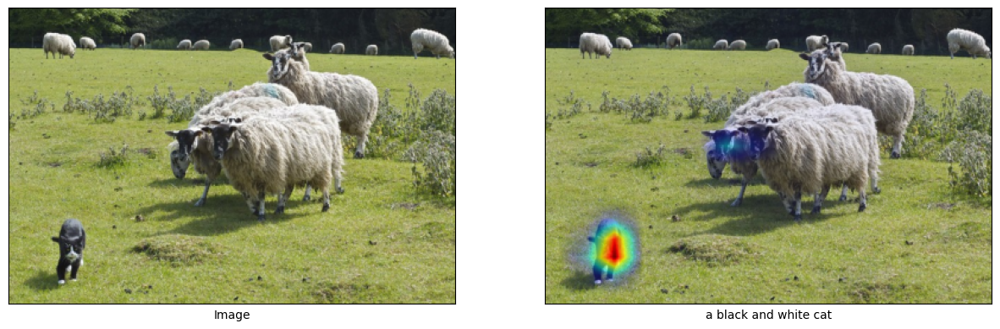

In [ ]:
gradcam = get_phrase_gradcam(text, image, model, tokenizer)
gradcam_shown = gradcam.view(1,1,16,16)
gradcam_shown = F.interpolate(
    gradcam_shown, (256,256), mode="bilinear", align_corners=False
).squeeze()

fig, ax = plt.subplots(1, 2, figsize=(15,20))

rgb_image = cv2.imread(image_path)[:, :, ::-1]
rgb_image = np.float32(rgb_image) / 255

ax[0].imshow(rgb_image)
ax[0].set_yticks([])
ax[0].set_xticks([])
ax[0].set_xlabel("Image")
word = text
#gradcam_image = getAttMap(rgb_image, gradcam_shown.detach().cpu(), blur = False,overlap = True)
gradcam_numpy = gradcam_shown.detach().cpu().numpy()

gradcam_image = getAttMap(rgb_image, gradcam_numpy, blur=False, overlap=True)

ax[1].imshow(gradcam_image)
ax[1].set_yticks([])
ax[1].set_xticks([])
ax[1].set_xlabel(word)

###Creating Saliency maps directly

In [ ]:
# Convert gradcam_shown (Tensor) to NumPy
gradcam_numpy = gradcam_shown.detach().cpu().numpy()

# Normalize the saliency map to [0, 255]
gradcam_normalized = (gradcam_numpy - gradcam_numpy.min()) / (gradcam_numpy.max() - gradcam_numpy.min() + 1e-8)
gradcam_uint8 = (gradcam_normalized * 255).astype(np.uint8)

# Save grayscale saliency map
saliency_map_path = '/content/AMC-grounding/test_images/saliency_map.png'
cv2.imwrite(saliency_map_path, gradcam_uint8)
print(f"Saved raw saliency map: {saliency_map_path}")

# Save overlay visualization using your getAttMap
rgb_image = np.array(image_pil).astype(np.float32) / 255.0
gradcam_overlay = getAttMap(rgb_image, gradcam_numpy, blur=False, overlap=True)

# Convert overlay to uint8 and BGR for OpenCV
gradcam_overlay_bgr = (gradcam_overlay[:, :, ::-1] * 255).astype(np.uint8)
overlay_path = '/content/AMC-grounding/test_images/saliency_overlay.png'
cv2.imwrite(overlay_path, gradcam_overlay_bgr)
print(f"Saved saliency overlay: {overlay_path}")

Saved raw saliency map: /content/AMC-grounding/test_images/saliency_map.png
Saved saliency overlay: /content/AMC-grounding/test_images/saliency_overlay.png


In [ ]:
zip_path = '/content/AMC-grounding/cosod.zip'
dataset_root = '/content/AMC-grounding/cosod/CoSOD3k/Image'

In [ ]:
gdown.download('https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6', zip_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6
From (redirected): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6&confirm=t&uuid=6e91818e-0d20-412d-8734-d361d61c775a
To: /content/AMC-grounding/cosod.zip
100%|██████████| 439M/439M [00:07<00:00, 60.4MB/s]


'/content/AMC-grounding/cosod.zip'

In [ ]:
import zipfile
gdown.download('https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6', zip_path, quiet=False)
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall('/content/AMC-grounding/cosod')

Downloading...
From (original): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6
From (redirected): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6&confirm=t&uuid=389cd673-b081-4937-a787-fe030be7634a
To: /content/AMC-grounding/cosod.zip
100%|██████████| 439M/439M [00:01<00:00, 275MB/s]


In [ ]:
image_path = '/content/AMC-grounding/cosod/CoSOD3k/GroundTruth/airplane/ILSVRC2012_val_00001390.png'
image_pil = Image.open(image_path).convert('RGB')
image = transform(image_pil).unsqueeze(0)

In [ ]:
w,h = image_pil.size

caption = 'airplane'
text = pre_caption(caption)

Text(0.5, 0, 'airplane')

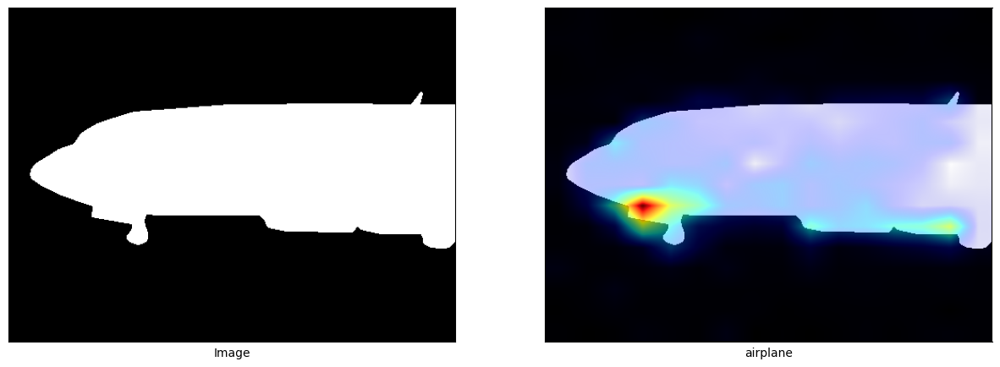

In [ ]:
gradcam = get_phrase_gradcam(text, image, model, tokenizer)
gradcam_shown = gradcam.view(1,1,16,16)
gradcam_shown = F.interpolate(
    gradcam_shown, (256,256), mode="bilinear", align_corners=False
).squeeze()

fig, ax = plt.subplots(1, 2, figsize=(15,20))

rgb_image = cv2.imread(image_path)[:, :, ::-1]
rgb_image = np.float32(rgb_image) / 255

ax[0].imshow(rgb_image)
ax[0].set_yticks([])
ax[0].set_xticks([])
ax[0].set_xlabel("Image")
word = text
#gradcam_image = getAttMap(rgb_image, gradcam_shown.detach().cpu(), blur = False,overlap = True)
gradcam_numpy = gradcam_shown.detach().cpu().numpy()

gradcam_image = getAttMap(rgb_image, gradcam_numpy, blur=False, overlap=True)

ax[1].imshow(gradcam_image)
ax[1].set_yticks([])
ax[1].set_xticks([])
ax[1].set_xlabel(word)

In [ ]:
# Convert gradcam_shown (Tensor) to NumPy
gradcam_numpy = gradcam_shown.detach().cpu().numpy()

# Normalize the saliency map to [0, 255]
gradcam_normalized = (gradcam_numpy - gradcam_numpy.min()) / (gradcam_numpy.max() - gradcam_numpy.min() + 1e-8)
gradcam_uint8 = (gradcam_normalized * 255).astype(np.uint8)

# Save grayscale saliency map
saliency_map_path = '/content/AMC-grounding/test_images/saliency_map_air.png'
cv2.imwrite(saliency_map_path, gradcam_uint8)
print(f"Saved raw saliency map: {saliency_map_path}")

# Save overlay visualization using your getAttMap
rgb_image = np.array(image_pil).astype(np.float32) / 255.0
gradcam_overlay = getAttMap(rgb_image, gradcam_numpy, blur=False, overlap=True)

# Convert overlay to uint8 and BGR for OpenCV
gradcam_overlay_bgr = (gradcam_overlay[:, :, ::-1] * 255).astype(np.uint8)
overlay_path = '/content/AMC-grounding/test_images/saliency_overlay_air.png'
cv2.imwrite(overlay_path, gradcam_overlay_bgr)
print(f"Saved saliency overlay: {overlay_path}")

Saved raw saliency map: /content/AMC-grounding/test_images/saliency_map_air.png
Saved saliency overlay: /content/AMC-grounding/test_images/saliency_overlay_air.png


##Otsu Thresholding

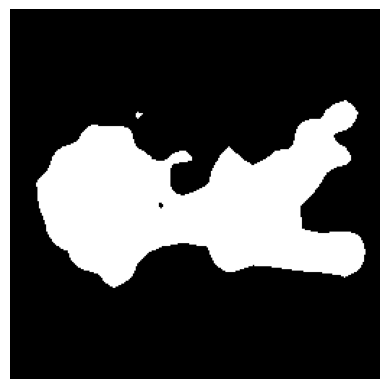

In [ ]:
from skimage.filters import threshold_otsu

# Assume gradcam_numpy is your normalized (0-1) attention map
otsu_thresh = threshold_otsu(gradcam_numpy)
binary_saliency_map = gradcam_numpy > otsu_thresh

# Optional: visualize the binary mask
plt.imshow(binary_saliency_map, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
zip_path = '/content/AMC-grounding/cosod.zip'
dataset_root = '/content/AMC-grounding/cosod/CoSOD3k/Image'
gdown.download('https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6', zip_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6
From (redirected): https://drive.google.com/uc?id=1-zkz9Zu3vvT7JB_n7jTZYiTxBpoigER6&confirm=t&uuid=839e24e1-44ca-4a0a-88ab-f43d95f324c4
To: /content/AMC-grounding/cosod.zip
100%|██████████| 439M/439M [00:07<00:00, 55.2MB/s]


'/content/AMC-grounding/cosod.zip'

In [ ]:
import zipfile
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall('/content/AMC-grounding/cosod')

In [ ]:
image_path = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane/ILSVRC2012_val_00001390.jpg'
image_pil = Image.open(image_path).convert('RGB')
image = transform(image_pil).unsqueeze(0)

In [ ]:
w,h = image_pil.size

caption = 'airplane'
text = pre_caption(caption)

Text(0.5, 0, 'airplane')

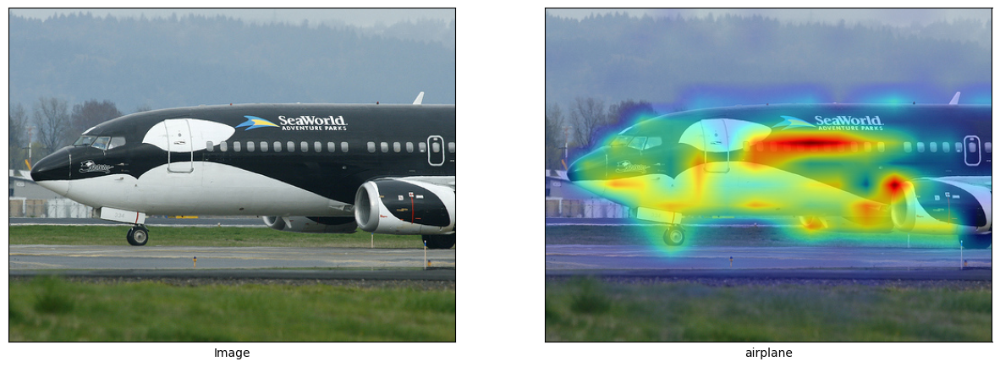

In [ ]:
gradcam = get_phrase_gradcam(text, image, model, tokenizer)
gradcam_shown = gradcam.view(1,1,16,16)
gradcam_shown = F.interpolate(
    gradcam_shown, (256,256), mode="bilinear", align_corners=False
).squeeze()

fig, ax = plt.subplots(1, 2, figsize=(15,20))

rgb_image = cv2.imread(image_path)[:, :, ::-1]
rgb_image = np.float32(rgb_image) / 255

ax[0].imshow(rgb_image)
ax[0].set_yticks([])
ax[0].set_xticks([])
ax[0].set_xlabel("Image")
word = text
#gradcam_image = getAttMap(rgb_image, gradcam_shown.detach().cpu(), blur = False,overlap = True)
gradcam_numpy = gradcam_shown.detach().cpu().numpy()

gradcam_image = getAttMap(rgb_image, gradcam_numpy, blur=False, overlap=True)

ax[1].imshow(gradcam_image)
ax[1].set_yticks([])
ax[1].set_xticks([])
ax[1].set_xlabel(word)

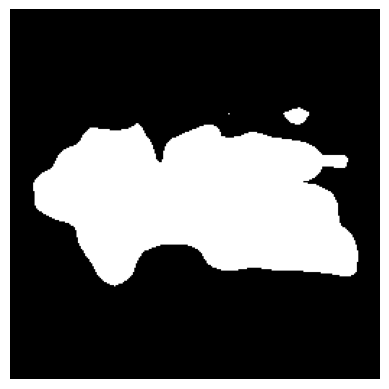

In [ ]:
# Assume gradcam_numpy is your normalized (0-1) attention map
otsu_thresh = threshold_otsu(gradcam_numpy)
binary_saliency_map = gradcam_numpy > otsu_thresh

# Optional: visualize the binary mask
plt.imshow(binary_saliency_map, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
import os
import glob
import numpy as np
from PIL import Image
from tqdm import tqdm
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from skimage import transform as skimage_transform
from skimage.filters import threshold_otsu
import cv2

# Setup paths
dataset_root = '/content/AMC-grounding/cosod/CoSOD3k/Image'
output_root = '/content/AMC-grounding/cosod_saliency_maps'

os.makedirs(output_root, exist_ok=True)

# Go over each category
categories = sorted(os.listdir(dataset_root))

for category in categories:
    category_path = os.path.join(dataset_root, category)
    if not os.path.isdir(category_path):
        continue

    print(f'Processing category: {category}')
    os.makedirs(os.path.join(output_root, category), exist_ok=True)

    # Use category name as the caption
    caption = category
    text = pre_caption(caption)

    image_files = glob.glob(os.path.join(category_path, '*'))

    for image_file in tqdm(image_files, desc=f'{category} images'):
        # Load image
        image_pil = Image.open(image_file).convert('RGB')
        image = transform(image_pil).unsqueeze(0).cuda()

        # Get Grad-CAM
        gradcam = get_phrase_gradcam(text, image, model,tokenizer)
        gradcam_shown = gradcam.view(1,1,16,16)
        gradcam_shown = F.interpolate(gradcam_shown, (256,256), mode="bilinear", align_corners=False).squeeze()
        gradcam_numpy = gradcam_shown.detach().cpu().numpy()

        # Apply Otsu thresholding
        otsu_thresh = threshold_otsu(gradcam_numpy)
        binary_saliency = gradcam_numpy > otsu_thresh

        # Resize to original image size
        binary_resized = skimage_transform.resize(binary_saliency, image_pil.size[::-1], order=0, preserve_range=True).astype(np.uint8)

        # Save as binary mask (e.g., PNG)
        output_path = os.path.join(output_root, category, os.path.basename(image_file))
        output_path = os.path.splitext(output_path)[0] + '_saliency.png'
        Image.fromarray((binary_resized * 255).astype(np.uint8)).save(output_path)

print('✅ Done generating saliency maps.')

Processing category: airplane


airplane images: 100%|██████████| 30/30 [00:02<00:00, 10.58it/s]


Processing category: ant


ant images: 100%|██████████| 22/22 [00:02<00:00, 10.68it/s]


Processing category: antelope


antelope images: 100%|██████████| 28/28 [00:03<00:00,  8.87it/s]


Processing category: apple


apple images: 100%|██████████| 18/18 [00:02<00:00,  8.73it/s]


Processing category: armadillo


armadillo images: 100%|██████████| 30/30 [00:02<00:00, 11.10it/s]


Processing category: artichoke


artichoke images: 100%|██████████| 14/14 [00:01<00:00, 10.85it/s]


Processing category: axe


axe images: 100%|██████████| 29/29 [00:02<00:00, 11.07it/s]


Processing category: baby_bed


baby_bed images: 100%|██████████| 11/11 [00:01<00:00, 10.60it/s]


Processing category: bagel


bagel images: 100%|██████████| 24/24 [00:02<00:00,  8.60it/s]


Processing category: banana


banana images: 100%|██████████| 18/18 [00:01<00:00, 10.78it/s]


Processing category: band_aid


band_aid images: 100%|██████████| 30/30 [00:02<00:00, 10.38it/s]


Processing category: banjo


banjo images: 100%|██████████| 20/20 [00:01<00:00, 11.13it/s]


Processing category: baseball


baseball images: 100%|██████████| 28/28 [00:02<00:00, 10.94it/s]


Processing category: basketball


basketball images: 100%|██████████| 9/9 [00:01<00:00,  8.56it/s]


Processing category: beaker


beaker images: 100%|██████████| 20/20 [00:02<00:00,  9.02it/s]


Processing category: bear


bear images: 100%|██████████| 30/30 [00:02<00:00, 11.10it/s]


Processing category: bee


bee images: 100%|██████████| 30/30 [00:02<00:00, 10.92it/s]


Processing category: bell_pepper


bell_pepper images: 100%|██████████| 18/18 [00:01<00:00, 10.38it/s]


Processing category: bench


bench images: 100%|██████████| 18/18 [00:01<00:00, 10.83it/s]


Processing category: bicycle


bicycle images: 100%|██████████| 18/18 [00:02<00:00,  8.89it/s]


Processing category: binder


binder images: 100%|██████████| 8/8 [00:00<00:00,  8.16it/s]


Processing category: bird


bird images: 100%|██████████| 29/29 [00:02<00:00, 10.69it/s]


Processing category: bookshelf


bookshelf images: 100%|██████████| 18/18 [00:01<00:00,  9.47it/s]


Processing category: bow


bow images: 100%|██████████| 8/8 [00:00<00:00, 10.57it/s]


Processing category: bow_tie


bow_tie images: 100%|██████████| 14/14 [00:01<00:00, 10.70it/s]


Processing category: bowl


bowl images: 100%|██████████| 9/9 [00:00<00:00, 10.63it/s]


Processing category: brassiere


brassiere images: 100%|██████████| 11/11 [00:01<00:00, 10.68it/s]


Processing category: bus


bus images: 100%|██████████| 30/30 [00:03<00:00,  8.86it/s]


Processing category: butterfly


butterfly images: 100%|██████████| 30/30 [00:02<00:00, 10.51it/s]


Processing category: camel


camel images: 100%|██████████| 30/30 [00:02<00:00, 10.75it/s]


Processing category: can_opener


can_opener images: 100%|██████████| 13/13 [00:01<00:00, 10.17it/s]


Processing category: car


car images: 100%|██████████| 29/29 [00:02<00:00, 10.09it/s]


Processing category: cart


cart images: 100%|██████████| 10/10 [00:01<00:00,  8.51it/s]


Processing category: cattle


cattle images: 100%|██████████| 25/25 [00:02<00:00,  9.23it/s]


Processing category: cello


cello images: 100%|██████████| 7/7 [00:00<00:00, 10.90it/s]


Processing category: centipede


centipede images: 100%|██████████| 22/22 [00:02<00:00, 10.72it/s]


Processing category: chain_saw


chain_saw images: 100%|██████████| 9/9 [00:00<00:00, 10.75it/s]


Processing category: chime


chime images: 100%|██████████| 28/28 [00:02<00:00, 10.63it/s]


Processing category: cocktail_shaker


cocktail_shaker images: 100%|██████████| 13/13 [00:01<00:00, 10.23it/s]


Processing category: computer_keyboard


computer_keyboard images: 100%|██████████| 10/10 [00:00<00:00, 10.58it/s]


Processing category: computer_mouse


computer_mouse images: 100%|██████████| 26/26 [00:03<00:00,  8.58it/s]


Processing category: cream


cream images: 100%|██████████| 24/24 [00:02<00:00, 10.57it/s]


Processing category: croquet_ball


croquet_ball images: 100%|██████████| 26/26 [00:02<00:00,  8.68it/s]


Processing category: crutch


crutch images: 100%|██████████| 23/23 [00:02<00:00, 10.66it/s]


Processing category: cucumber


cucumber images: 100%|██████████| 19/19 [00:01<00:00, 10.76it/s]


Processing category: cup_or_mug


cup_or_mug images: 100%|██████████| 19/19 [00:02<00:00,  8.57it/s]


Processing category: digital_clock


digital_clock images: 100%|██████████| 14/14 [00:01<00:00, 10.56it/s]


Processing category: dog


dog images: 100%|██████████| 30/30 [00:02<00:00, 10.73it/s]


Processing category: domestic_cat


domestic_cat images: 100%|██████████| 30/30 [00:05<00:00,  5.82it/s]


Processing category: dragonfly


dragonfly images: 100%|██████████| 30/30 [00:03<00:00,  8.69it/s]


Processing category: drum


drum images: 100%|██████████| 12/12 [00:01<00:00, 10.64it/s]


Processing category: dumbbell


dumbbell images: 100%|██████████| 21/21 [00:01<00:00, 10.52it/s]


Processing category: electric_fan


electric_fan images: 100%|██████████| 12/12 [00:01<00:00, 10.29it/s]


Processing category: elephant


elephant images: 100%|██████████| 30/30 [00:03<00:00,  8.00it/s]


Processing category: face_powder


face_powder images: 100%|██████████| 21/21 [00:02<00:00, 10.31it/s]


Processing category: fig


fig images: 100%|██████████| 19/19 [00:02<00:00,  8.58it/s]


Processing category: flower_pot


flower_pot images: 100%|██████████| 10/10 [00:00<00:00, 10.67it/s]


Processing category: flute


flute images: 100%|██████████| 21/21 [00:02<00:00,  9.87it/s]


Processing category: fox


fox images: 100%|██████████| 30/30 [00:02<00:00, 10.71it/s]


Processing category: french_horn


french_horn images: 100%|██████████| 4/4 [00:00<00:00, 10.20it/s]


Processing category: frog


frog images: 100%|██████████| 29/29 [00:02<00:00, 10.48it/s]


Processing category: frying_pan


frying_pan images: 100%|██████████| 17/17 [00:01<00:00,  8.64it/s]


Processing category: giant_panda


giant_panda images: 100%|██████████| 30/30 [00:03<00:00,  9.90it/s]


Processing category: goldfish


goldfish images: 100%|██████████| 30/30 [00:02<00:00, 10.65it/s]


Processing category: golf_ball


golf_ball images: 100%|██████████| 28/28 [00:02<00:00, 10.21it/s]


Processing category: golfcart


golfcart images: 100%|██████████| 14/14 [00:01<00:00, 10.58it/s]


Processing category: guitar


guitar images: 100%|██████████| 21/21 [00:02<00:00,  9.36it/s]


Processing category: hair_dryer


hair_dryer images: 100%|██████████| 22/22 [00:02<00:00,  9.40it/s]


Processing category: hair_spray


hair_spray images: 100%|██████████| 20/20 [00:01<00:00, 10.83it/s]


Processing category: hamburger


hamburger images: 100%|██████████| 21/21 [00:01<00:00, 10.79it/s]


Processing category: hammer


hammer images: 100%|██████████| 13/13 [00:01<00:00, 10.62it/s]


Processing category: hamster


hamster images: 100%|██████████| 21/21 [00:02<00:00, 10.44it/s]


Processing category: harmonica


harmonica images: 100%|██████████| 14/14 [00:01<00:00, 10.15it/s]


Processing category: harp


harp images: 100%|██████████| 9/9 [00:01<00:00,  7.93it/s]


Processing category: hat_with_a_wide_brim


hat_with_a_wide_brim images: 100%|██████████| 27/27 [00:02<00:00,  9.35it/s]


Processing category: head_cabbage


head_cabbage images: 100%|██████████| 9/9 [00:00<00:00, 10.69it/s]


Processing category: helmet


helmet images: 100%|██████████| 8/8 [00:00<00:00, 10.74it/s]


Processing category: hippopotamus


hippopotamus images: 100%|██████████| 30/30 [00:02<00:00, 10.64it/s]


Processing category: horse


horse images: 100%|██████████| 30/30 [00:02<00:00, 10.60it/s]


Processing category: iPod


iPod images: 100%|██████████| 22/22 [00:02<00:00,  9.63it/s]


Processing category: isopod


isopod images: 100%|██████████| 27/27 [00:02<00:00,  9.50it/s]


Processing category: jellyfish


jellyfish images: 100%|██████████| 29/29 [00:02<00:00, 10.75it/s]


Processing category: koala_bear


koala_bear images: 100%|██████████| 30/30 [00:02<00:00, 10.50it/s]


Processing category: ladybug


ladybug images: 100%|██████████| 30/30 [00:02<00:00, 10.60it/s]


Processing category: lamp


lamp images: 100%|██████████| 9/9 [00:01<00:00,  8.45it/s]


Processing category: laptop


laptop images: 100%|██████████| 11/11 [00:01<00:00,  8.15it/s]


Processing category: lemon


lemon images: 100%|██████████| 19/19 [00:01<00:00, 10.85it/s]


Processing category: lion


lion images: 100%|██████████| 21/21 [00:01<00:00, 11.02it/s]


Processing category: lipstick


lipstick images: 100%|██████████| 23/23 [00:02<00:00, 10.47it/s]


Processing category: lizard


lizard images: 100%|██████████| 28/28 [00:02<00:00, 10.61it/s]


Processing category: lobster


lobster images: 100%|██████████| 16/16 [00:02<00:00,  5.84it/s]


Processing category: maraca


maraca images: 100%|██████████| 28/28 [00:02<00:00,  9.72it/s]


Processing category: microwave


microwave images: 100%|██████████| 8/8 [00:00<00:00, 10.60it/s]


Processing category: milk_can


milk_can images: 100%|██████████| 16/16 [00:01<00:00, 10.40it/s]


Processing category: monkey


monkey images: 100%|██████████| 30/30 [00:02<00:00, 10.53it/s]


Processing category: motorcycle


motorcycle images: 100%|██████████| 20/20 [00:01<00:00, 10.51it/s]


Processing category: mushroom


mushroom images: 100%|██████████| 30/30 [00:03<00:00,  8.79it/s]


Processing category: nail


nail images: 100%|██████████| 22/22 [00:02<00:00, 10.79it/s]


Processing category: oboe


oboe images: 100%|██████████| 14/14 [00:01<00:00,  7.39it/s]


Processing category: orange


orange images: 100%|██████████| 11/11 [00:02<00:00,  3.90it/s]


Processing category: otter


otter images: 100%|██████████| 30/30 [00:02<00:00, 10.66it/s]


Processing category: pencil_box


pencil_box images: 100%|██████████| 11/11 [00:01<00:00,  8.41it/s]


Processing category: perfume


perfume images: 100%|██████████| 27/27 [00:02<00:00,  9.62it/s]


Processing category: person


person images: 100%|██████████| 21/21 [00:01<00:00, 10.56it/s]


Processing category: piano


piano images: 100%|██████████| 5/5 [00:00<00:00, 10.32it/s]


Processing category: pineapple


pineapple images: 100%|██████████| 21/21 [00:02<00:00, 10.39it/s]


Processing category: pitcher


pitcher images: 100%|██████████| 21/21 [00:01<00:00, 10.54it/s]


Processing category: pizza


pizza images: 100%|██████████| 17/17 [00:01<00:00, 10.38it/s]


Processing category: pomegranate


pomegranate images: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s]


Processing category: popsicle


popsicle images: 100%|██████████| 22/22 [00:02<00:00, 10.55it/s]


Processing category: porcupine


porcupine images: 100%|██████████| 30/30 [00:02<00:00, 10.66it/s]


Processing category: power_drill


power_drill images: 100%|██████████| 17/17 [00:01<00:00, 10.74it/s]


Processing category: pretzel


pretzel images: 100%|██████████| 10/10 [00:00<00:00, 10.53it/s]


Processing category: punching_bag


punching_bag images: 100%|██████████| 13/13 [00:01<00:00, 10.51it/s]


Processing category: purse


purse images: 100%|██████████| 20/20 [00:02<00:00,  9.73it/s]


Processing category: rabbit


rabbit images: 100%|██████████| 30/30 [00:03<00:00,  9.69it/s]


Processing category: ray


ray images: 100%|██████████| 29/29 [00:02<00:00, 10.58it/s]


Processing category: red_panda


red_panda images: 100%|██████████| 30/30 [00:02<00:00, 10.57it/s]


Processing category: refrigerator


refrigerator images: 100%|██████████| 11/11 [00:01<00:00, 10.40it/s]


Processing category: remote_control


remote_control images: 100%|██████████| 23/23 [00:02<00:00,  9.46it/s]


Processing category: rubber_eraser


rubber_eraser images: 100%|██████████| 23/23 [00:02<00:00,  9.11it/s]


Processing category: rugby_ball


rugby_ball images: 100%|██████████| 12/12 [00:01<00:00, 10.66it/s]


Processing category: salt_or_pepper_shaker


salt_or_pepper_shaker images: 100%|██████████| 30/30 [00:02<00:00, 10.04it/s]


Processing category: scorpion


scorpion images: 100%|██████████| 30/30 [00:02<00:00, 10.50it/s]


Processing category: screwdriver


screwdriver images: 100%|██████████| 19/19 [00:01<00:00, 10.59it/s]


Processing category: seal


seal images: 100%|██████████| 27/27 [00:03<00:00,  8.84it/s]


Processing category: sheep


sheep images: 100%|██████████| 30/30 [00:02<00:00, 10.51it/s]


Processing category: skunk


skunk images: 100%|██████████| 30/30 [00:02<00:00, 10.52it/s]


Processing category: snail


snail images: 100%|██████████| 29/29 [00:02<00:00, 10.41it/s]


Processing category: snake


snake images: 100%|██████████| 28/28 [00:03<00:00,  8.68it/s]


Processing category: snowmobile


snowmobile images: 100%|██████████| 10/10 [00:00<00:00, 10.87it/s]


Processing category: snowplow


snowplow images: 100%|██████████| 27/27 [00:02<00:00, 10.67it/s]


Processing category: soap_dispenser


soap_dispenser images: 100%|██████████| 16/16 [00:01<00:00, 10.57it/s]


Processing category: soccer_ball


soccer_ball images: 100%|██████████| 29/29 [00:02<00:00, 10.69it/s]


Processing category: sofa


sofa images: 100%|██████████| 9/9 [00:00<00:00, 10.80it/s]


Processing category: spatula


spatula images: 100%|██████████| 16/16 [00:01<00:00, 10.04it/s]


Processing category: squirrel


squirrel images: 100%|██████████| 30/30 [00:03<00:00,  9.09it/s]


Processing category: starfish


starfish images: 100%|██████████| 29/29 [00:02<00:00, 10.43it/s]


Processing category: stethoscope


stethoscope images: 100%|██████████| 8/8 [00:00<00:00, 10.68it/s]


Processing category: strainer


strainer images: 100%|██████████| 18/18 [00:01<00:00, 10.55it/s]


Processing category: strawberry


strawberry images: 100%|██████████| 15/15 [00:01<00:00, 10.38it/s]


Processing category: swine


swine images: 100%|██████████| 30/30 [00:03<00:00,  9.44it/s]


Processing category: syringe


syringe images: 100%|██████████| 20/20 [00:02<00:00,  9.35it/s]


Processing category: tape_player


tape_player images: 100%|██████████| 26/26 [00:02<00:00, 10.45it/s]


Processing category: tennis_ball


tennis_ball images: 100%|██████████| 28/28 [00:02<00:00, 10.64it/s]


Processing category: tick


tick images: 100%|██████████| 20/20 [00:01<00:00, 10.44it/s]


Processing category: tie


tie images: 100%|██████████| 13/13 [00:01<00:00, 10.55it/s]


Processing category: tiger


tiger images: 100%|██████████| 30/30 [00:03<00:00,  8.73it/s]


Processing category: toaster


toaster images: 100%|██████████| 11/11 [00:01<00:00, 10.74it/s]


Processing category: traffic_light


traffic_light images: 100%|██████████| 21/21 [00:01<00:00, 10.52it/s]


Processing category: train


train images: 100%|██████████| 10/10 [00:00<00:00, 10.85it/s]


Processing category: trumpet


trumpet images: 100%|██████████| 9/9 [00:00<00:00, 10.83it/s]


Processing category: turtle


turtle images: 100%|██████████| 30/30 [00:02<00:00, 10.42it/s]


Processing category: violin


violin images: 100%|██████████| 7/7 [00:00<00:00, 10.32it/s]


Processing category: washer


washer images: 100%|██████████| 10/10 [00:00<00:00, 10.05it/s]


Processing category: water_bottle


water_bottle images: 100%|██████████| 22/22 [00:02<00:00,  8.51it/s]


Processing category: watercraft


watercraft images: 100%|██████████| 22/22 [00:02<00:00, 10.33it/s]


Processing category: whale


whale images: 100%|██████████| 30/30 [00:02<00:00, 10.72it/s]


Processing category: wine_bottle


wine_bottle images: 100%|██████████| 22/22 [00:02<00:00, 10.51it/s]


Processing category: zebra


zebra images: 100%|██████████| 26/26 [00:02<00:00, 10.47it/s]

✅ Done generating saliency maps.


##DGCNet

In [ ]:
%cd ..

/content


In [ ]:
!pwd

/content


In [ ]:
!git clone https://github.com/AaltoVision/DGC-Net.git

Cloning into 'DGC-Net'...
remote: Enumerating objects: 233, done.
remote: Counting objects: 100% (18/18), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 233 (delta 8), reused 15 (delta 6), pack-reused 215 (from 1)
Receiving objects: 100% (233/233), 9.05 MiB | 6.88 MiB/s, done.
Resolving deltas: 100% (105/105), done.


In [ ]:
#1p1FarlU5byWez_mQC68DZ_eRQKfF9IIf
zip_path = '/content/checkpt.zip'
#dataset_root = '/content/AMC-grounding/cosod/CoSOD3k/Image'
gdown.download('https://drive.google.com/uc?id=1p1FarlU5byWez_mQC68DZ_eRQKfF9IIf', zip_path, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1p1FarlU5byWez_mQC68DZ_eRQKfF9IIf
From (redirected): https://drive.google.com/uc?id=1p1FarlU5byWez_mQC68DZ_eRQKfF9IIf&confirm=t&uuid=287ef2f6-8788-4d28-a9c3-bc09446dd82e
To: /content/checkpt.zip
100%|██████████| 113M/113M [00:02<00:00, 48.4MB/s]


'/content/checkpt.zip'

In [ ]:
import zipfile
with zipfile.ZipFile('/content/checkpt.zip', 'r') as zip_ref:
    zip_ref.extractall('/content')

In [ ]:
import os
import sys

os.chdir('/content/DGC-Net')
# Remove conflicting paths (like U-2-Net) from sys.path if present
sys.path = [p for p in sys.path if 'U-2-Net' not in p]
# Insert DGC-Net at the front
if os.getcwd() not in sys.path:
    sys.path.insert(0, os.getcwd())

In [ ]:
modules_to_delete = [key for key in sys.modules.keys() if key.startswith('model')]
for key in modules_to_delete:
    del sys.modules[key]

print(f"Deleted cached modules: {modules_to_delete}")

Deleted cached modules: ['models', 'models.vit', 'models.tokenization_bert', 'models.xbert', 'models.model_eval']


In [ ]:
from model import modules
from model import net

DGCNet = net.DGCNet
print("Modules imported successfully!")

Modules imported successfully!


In [ ]:
import torch

dgc_model = DGCNet()
checkpoint_path = '/content/pretrained_models/dgc/checkpoint.pth'

checkpoint = torch.load(checkpoint_path, map_location='cpu')
print("Checkpoint keys:", checkpoint.keys())  # just to confirm

dgc_model.load_state_dict(checkpoint['state_dict'])
dgc_model.eval()

print("DGCNet loaded successfully!")

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 166MB/s]


Checkpoint keys: dict_keys(['state_dict', 'optimizer'])
DGCNet loaded successfully!


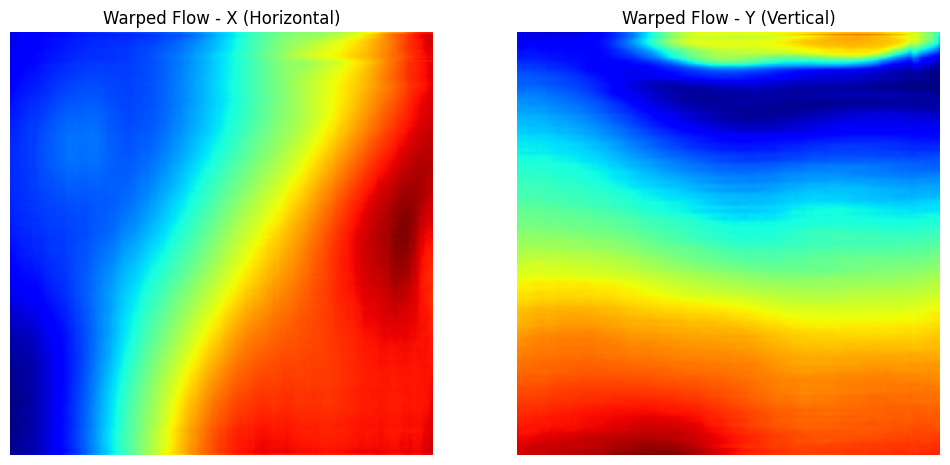

In [ ]:
import cv2
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np

# --- Set device ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Paths to two input images ---
img1_path = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane/ILSVRC2012_val_00001390.jpg'
img2_path = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane/ILSVRC2012_val_00004089.jpg'

# --- Load and preprocess images ---
def load_and_preprocess(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img, (240, 240))  # Adjust size as expected by DGCNet
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img_resized).unsqueeze(0).to(device)  # [1, 3, H, W]
    return img_tensor, img_resized

#img1_tensor = load_and_preprocess(img1_path)
img1_tensor, img1_resized = load_and_preprocess(img1_path)
#img2_tensor = load_and_preprocess(img2_path)
img2_tensor, img1_resized = load_and_preprocess(img2_path)
# --- Load DGCNet model ---
# Make sure you have loaded/initialized your dgc_model here
dgc_model = dgc_model.to(device)
dgc_model.eval()

# --- Run DGCNet to get warped flow (W est) ---
with torch.no_grad():
    warped_output, matchability = dgc_model(img1_tensor, img2_tensor)

# Get the final (highest resolution) warp output
final_warped = warped_output[-1]  # [batch, 2, H, W]

# Convert to numpy for visualization
final_warped_np = final_warped.squeeze().permute(1, 2, 0).cpu().numpy()  # [H, W, 2]

# Normalize for visualization
final_warped_norm = (final_warped_np - final_warped_np.min()) / (final_warped_np.max() - final_warped_np.min())

# --- Visualization ---
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Warped Flow - X (Horizontal)")
plt.imshow(final_warped_norm[:, :, 0], cmap='jet')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Warped Flow - Y (Vertical)")
plt.imshow(final_warped_norm[:, :, 1], cmap='jet')
plt.axis('off')

plt.show()


In [ ]:
warped_output

[tensor([[[[-7.9157e-01, -6.8697e-01, -6.3702e-01, -6.0922e-01, -5.7306e-01,
            -4.6855e-01, -3.5418e-01, -2.1840e-01, -1.2185e-01, -2.2326e-02,
             6.8478e-02,  1.9326e-01,  3.3816e-01,  5.2487e-01,  5.9464e-01],
           [-8.0482e-01, -6.6986e-01, -6.1760e-01, -6.1558e-01, -5.9467e-01,
            -4.9696e-01, -3.6845e-01, -2.3952e-01, -1.4212e-01, -4.7382e-02,
             3.8989e-02,  1.4948e-01,  2.7112e-01,  4.5943e-01,  5.5295e-01],
           [-7.6944e-01, -6.4044e-01, -5.9219e-01, -6.1817e-01, -6.2166e-01,
            -5.6092e-01, -4.2818e-01, -2.9155e-01, -1.7690e-01, -7.2953e-02,
             3.2538e-02,  1.6416e-01,  3.1838e-01,  5.1079e-01,  5.3177e-01],
           [-7.5034e-01, -6.3138e-01, -6.0341e-01, -6.5368e-01, -6.7482e-01,
            -6.4649e-01, -4.9317e-01, -3.3834e-01, -2.0551e-01, -8.4588e-02,
             3.7426e-02,  1.9019e-01,  3.5930e-01,  5.5808e-01,  5.5541e-01],
           [-7.2701e-01, -6.3895e-01, -6.4510e-01, -6.9750e-01, -6.9628e

In [ ]:
print("W* (estimated dense flow):")
print(final_warped_np)  # This will print the full 2D flow array

W* (estimated dense flow):
[[[-0.81421363 -0.7910777 ]
  [-0.8371087  -0.89405686]
  [-0.83337176 -0.8819406 ]
  ...
  [ 0.650109   -0.25771746]
  [ 0.6549837  -0.28397974]
  [ 0.59880614 -0.33854505]]

 [[-0.869227   -0.886971  ]
  [-0.84636307 -0.89455765]
  [-0.8485036  -0.89459157]
  ...
  [ 0.7257575  -0.20257242]
  [ 0.7241635  -0.22518621]
  [ 0.7110375  -0.33805   ]]

 [[-0.85275036 -0.8630809 ]
  [-0.8479293  -0.883908  ]
  [-0.84950435 -0.88300073]
  ...
  [ 0.7387721  -0.25590694]
  [ 0.735882   -0.2821676 ]
  [ 0.7091342  -0.3971141 ]]

 ...

 [[-0.9819388   0.6450491 ]
  [-1.0057683   0.638908  ]
  [-1.0078306   0.6333489 ]
  ...
  [ 0.7096359   0.5280825 ]
  [ 0.7304531   0.52212226]
  [ 0.73556054  0.528938  ]]

 [[-1.0003073   0.6409286 ]
  [-1.004517    0.64585066]
  [-1.0045898   0.6340671 ]
  ...
  [ 0.70181584  0.53500634]
  [ 0.7159928   0.52820396]
  [ 0.7314979   0.5317759 ]]

 [[-0.88600147  0.60005075]
  [-0.9676267   0.66918653]
  [-0.9716316   0.647161  ]
  .

In [ ]:
saliency_path = '/content/AMC-grounding/cosod_saliency_maps/airplane/ILSVRC2012_val_00004089_saliency.png'

# Load as grayscale → shape [H, W]
saliency_map_np = cv2.imread(saliency_path, cv2.IMREAD_GRAYSCALE)

# Normalize to [0, 1]
saliency_map_np = saliency_map_np / 255.0
print("Loaded saliency map shape:", saliency_map_np.shape)


Loaded saliency map shape: (336, 500)


In [ ]:
if saliency_map_np.shape != final_warped_np.shape[:2]:
    saliency_map_resized = cv2.resize(saliency_map_np, (final_warped_np.shape[1], final_warped_np.shape[0]))
else:
    saliency_map_resized = saliency_map_np

# Expand to 3D for broadcasting → [H, W, 1]
saliency_mask_3ch = np.expand_dims(saliency_map_resized, axis=-1)


In [ ]:
fused_output = final_warped_np * saliency_mask_3ch  # shape [H, W, 2]

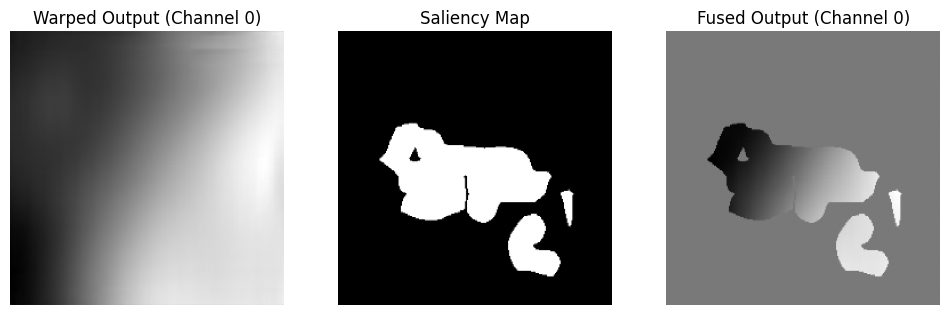

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 3, 1)
plt.title('Warped Output (Channel 0)')
plt.imshow(final_warped_np[:, :, 0], cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title('Saliency Map')
plt.imshow(saliency_map_resized, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Fused Output (Channel 0)')
plt.imshow(fused_output[:, :, 0], cmap='gray')
plt.axis('off')

plt.show()

In [ ]:
alpha = 0.5  # weight
fused_output = alpha * final_warped_np + (1 - alpha) * saliency_mask_3ch

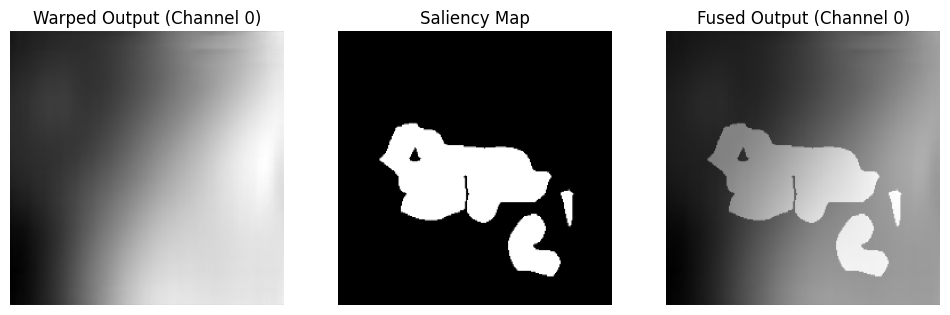

In [ ]:
plt.figure(figsize=(12, 5))

plt.subplot(1, 3, 1)
plt.title('Warped Output (Channel 0)')
plt.imshow(final_warped_np[:, :, 0], cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title('Saliency Map')
plt.imshow(saliency_map_resized, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('Fused Output (Channel 0)')
plt.imshow(fused_output[:, :, 0], cmap='gray')
plt.axis('off')

plt.show()


In [ ]:
import torch.nn.functional as F

def warp_saliency_with_flow(saliency_np, flow_tensor):
    """
    saliency_np: numpy array [H, W], range [0, 1]
    flow_tensor: torch tensor [1, 2, H, W] from DGCNet (W_est)
    """
    H, W = saliency_np.shape

    # Convert saliency map to tensor
    saliency_tensor = torch.from_numpy(saliency_np).unsqueeze(0).unsqueeze(0).float().to(flow_tensor.device)  # [1, 1, H, W]

    # Create mesh grid
    grid_y, grid_x = torch.meshgrid(
        torch.linspace(-1.0, 1.0, H, device=flow_tensor.device),
        torch.linspace(-1.0, 1.0, W, device=flow_tensor.device),
        indexing='ij'
    )
    base_grid = torch.stack((grid_x, grid_y), dim=-1).unsqueeze(0)  # [1, H, W, 2]

    # Normalize flow to [-1, 1] range (for grid_sample)
    norm_flow = flow_tensor.clone()
    norm_flow[:, 0, :, :] /= (W / 2.0)
    norm_flow[:, 1, :, :] /= (H / 2.0)

    # Convert flow to sampling grid
    sampling_grid = base_grid + norm_flow.permute(0, 2, 3, 1)  # [1, H, W, 2]

    # Warp the saliency map
    warped_saliency_tensor = F.grid_sample(saliency_tensor, sampling_grid, mode='bilinear', padding_mode='border', align_corners=True)

    # Convert back to numpy
    warped_saliency_np = warped_saliency_tensor.squeeze().cpu().numpy()
    return warped_saliency_np

In [ ]:
warped_saliency_map = warp_saliency_with_flow(saliency_map_resized, final_warped)

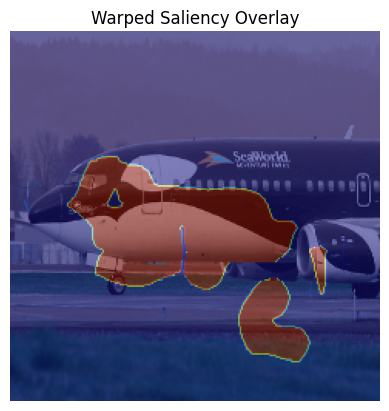

In [ ]:
source_image = cv2.imread(img1_path)
source_image = cv2.resize(source_image, (240, 240))
plt.imshow(source_image)
plt.imshow(warped_saliency_map, cmap='jet', alpha=0.5)
plt.title("Warped Saliency Overlay")
plt.axis('off')
plt.show()

In [ ]:
print("Flow min/max:", final_warped.min().item(), final_warped.max().item())

Flow min/max: -1.0617845058441162 0.862415075302124


In [ ]:
import torch.nn.functional as F

def warp_image_with_flow(source_img, flow):
    """
    Warp the source image using the estimated optical flow (W_est).
    source_img: shape [1, 3, H, W]
    flow: shape [1, 2, H, W]
    Returns: warped image, same shape as source
    """
    B, C, H, W = source_img.shape
    # Create normalized grid
    grid_y, grid_x = torch.meshgrid(torch.arange(0, H), torch.arange(0, W), indexing='ij')
    grid = torch.stack((grid_x, grid_y), dim=0).float().to(flow.device)  # [2, H, W]

    # Add flow to base grid
    vgrid = grid + flow.squeeze(0)  # [2, H, W]

    # Normalize to [-1, 1]
    vgrid[0] = 2.0 * vgrid[0] / (W - 1) - 1.0
    vgrid[1] = 2.0 * vgrid[1] / (H - 1) - 1.0
    vgrid = vgrid.permute(1, 2, 0).unsqueeze(0)  # [1, H, W, 2]

    # Sample using grid_sample
    warped = F.grid_sample(source_img, vgrid, mode='bilinear', padding_mode='border', align_corners=True)
    return warped

In [ ]:
warped_source = warp_image_with_flow(img1_tensor, final_warped)  # [1, 3, H, W]

In [ ]:
from skimage.metrics import structural_similarity as ssim
import torchvision

# Convert tensors to numpy for visualization
img2_np = img2_tensor.squeeze().permute(1, 2, 0).cpu().numpy()
warped_np = warped_source.squeeze().permute(1, 2, 0).cpu().numpy()

# Compute SSIM (grayscale)
gray1 = cv2.cvtColor((img2_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
gray2 = cv2.cvtColor((warped_np * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
score = ssim(gray1, gray2)

print("SSIM between warped source and target:", score)

SSIM between warped source and target: 0.07100088206083638


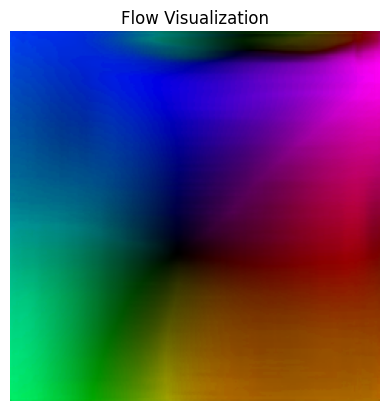

In [ ]:
import matplotlib.pyplot as plt

def visualize_flow(flow_np):
    hsv = np.zeros((flow_np.shape[0], flow_np.shape[1], 3), dtype=np.uint8)
    mag, ang = cv2.cartToPolar(flow_np[..., 0], flow_np[..., 1])
    hsv[..., 0] = ang * 180 / np.pi / 2  # Hue
    hsv[..., 1] = 255  # Saturation
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
    rgb_flow = cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)
    return rgb_flow

flow_vis = visualize_flow(final_warped_np)
plt.imshow(flow_vis)
plt.title("Flow Visualization")
plt.axis('off')
plt.show()

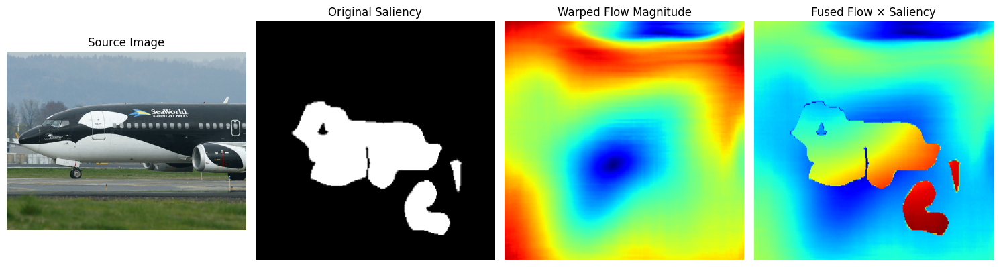

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Magnitude of flow for visualization
flow_mag = np.linalg.norm(final_warped_np, axis=2)  # shape [H, W]
fused_mag = np.linalg.norm(fused_output, axis=2)    # shape [H, W]

plt.figure(figsize=(15, 4))

plt.subplot(1, 4, 1)
plt.title("Source Image")
plt.imshow(cv2.cvtColor(cv2.imread(img1_path), cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 4, 2)
plt.title("Original Saliency")
plt.imshow(saliency_map_resized, cmap='gray')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.title("Warped Flow Magnitude")
plt.imshow(flow_mag, cmap='jet')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.title("Fused Flow × Saliency")
plt.imshow(fused_mag, cmap='jet')
plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
W_mag = np.linalg.norm(final_warped_np, axis=2)
W_mag_norm = (W_mag - W_mag.min()) / (W_mag.max() - W_mag.min())
fused_saliency = saliency_map_resized * W_mag_norm

In [ ]:
fused_saliency = np.sqrt(saliency_map_resized * W_mag_norm)

In [ ]:
print("Saliency max/min:", saliency_map_resized.max(), saliency_map_resized.min())
print("Flow mag max/min:", W_mag_norm.max(), W_mag_norm.min())
print("Fused saliency max/min:", fused_saliency.max(), fused_saliency.min())

Saliency max/min: 1.0 0.0
Flow mag max/min: 1.0 0.0
Fused saliency max/min: 0.7734534522058758 0.0


Text(0.5, 1.0, 'Fused - Original Saliency Difference')

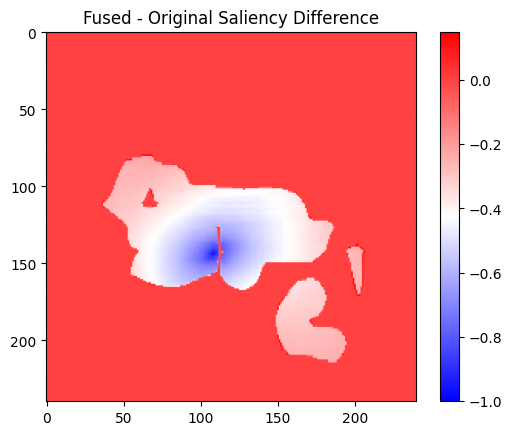

In [ ]:
difference_map = fused_saliency - saliency_map_resized
plt.imshow(difference_map, cmap='bwr')  # Red/blue diff
plt.colorbar()
plt.title("Fused - Original Saliency Difference")

Text(0.5, 1.0, 'Fused Binary')

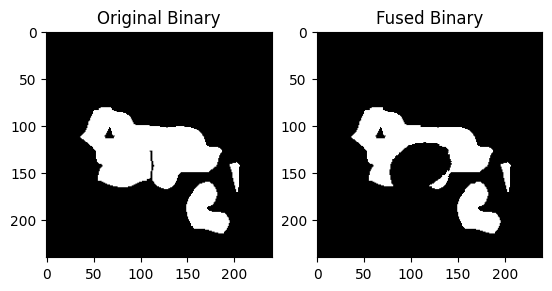

In [ ]:
_, binary_original = cv2.threshold(saliency_map_resized, 0.5, 1, cv2.THRESH_BINARY)
_, binary_fused = cv2.threshold(fused_saliency, 0.5, 1, cv2.THRESH_BINARY)

plt.subplot(1, 2, 1)
plt.imshow(binary_original, cmap='gray')
plt.title("Original Binary")

plt.subplot(1, 2, 2)
plt.imshow(binary_fused, cmap='gray')
plt.title("Fused Binary")

In [ ]:
saliency_bin = (saliency_map_resized > 0.5).astype(np.float32)

# Average flow magnitude inside saliency vs. outside
flow_inside = fused_mag[saliency_bin == 1].mean()
flow_outside = fused_mag[saliency_bin == 0].mean()

print(f"Avg fused flow magnitude inside saliency: {flow_inside:.4f}")
print(f"Avg fused flow magnitude outside saliency: {flow_outside:.4f}")

Avg fused flow magnitude inside saliency: 0.6980
Avg fused flow magnitude outside saliency: 0.3862


In [ ]:
fused_saliency = fused_output[:, :, 0]  # or use mean across channels if needed

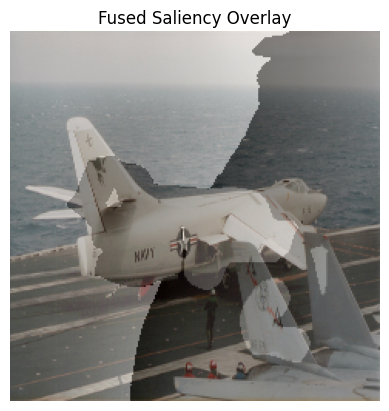

In [ ]:
fused_vis = (fused_saliency * 255).astype(np.uint8)
overlay = cv2.addWeighted(img1_resized, 0.6, cv2.cvtColor(fused_vis, cv2.COLOR_GRAY2RGB), 0.4, 0)

plt.imshow(overlay)
plt.title("Fused Saliency Overlay")
plt.axis("off")
plt.show()

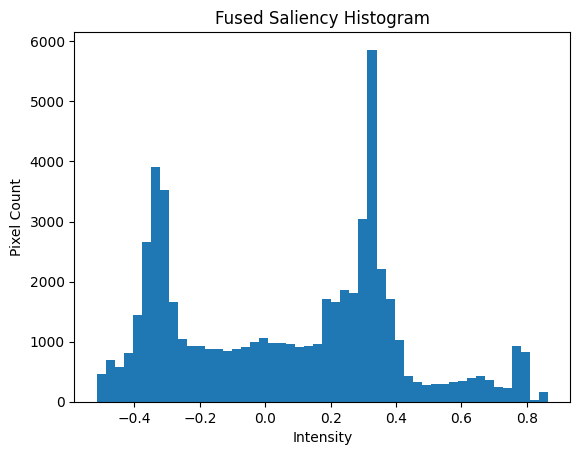

In [ ]:
plt.hist(fused_saliency.ravel(), bins=50)
plt.title("Fused Saliency Histogram")
plt.xlabel("Intensity")
plt.ylabel("Pixel Count")
plt.show()

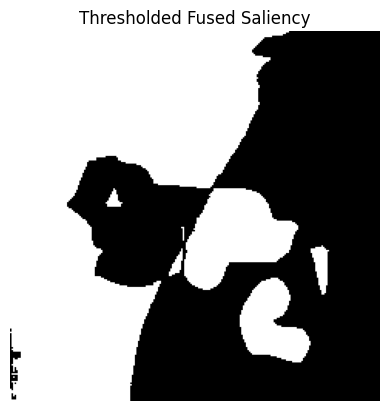

In [ ]:
_, binary = cv2.threshold((fused_saliency * 255).astype(np.uint8), 128, 255, cv2.THRESH_BINARY)
plt.imshow(binary, cmap='gray')
plt.title("Thresholded Fused Saliency")
plt.axis('off')
plt.show()

Processing target images: 100%|██████████| 29/29 [00:01<00:00, 27.38it/s]


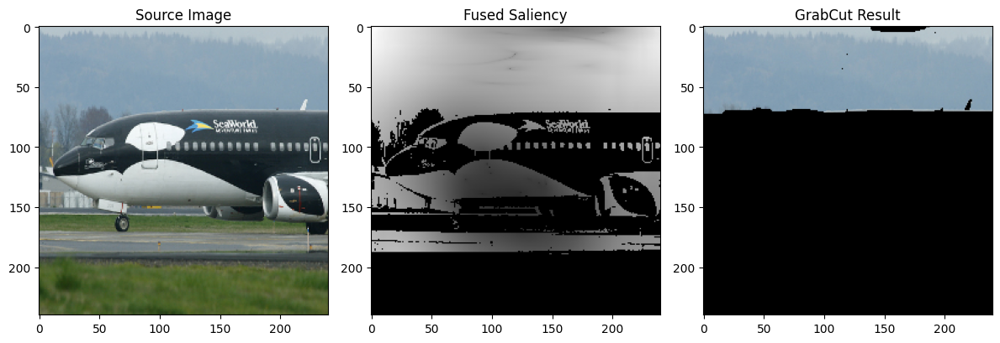

In [ ]:
import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from torchvision import transforms

# --- Init ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
image_list = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.jpg')])
dgc_model = dgc_model.to(device).eval()  # Ensure model is loaded

# --- Transforms ---
preprocess = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

def load_image(img_path):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img, (240, 240))
    img_tensor = preprocess(img_resized).unsqueeze(0).to(device)
    return img_tensor, img_resized

def generate_saliency_otsu(img_gray):
    _, mask = cv2.threshold(img_gray, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return mask.astype(np.float32)

def compute_flow_magnitude(warp):
    flow_mag = np.linalg.norm(warp, axis=-1)  # shape: (H, W)
    return (flow_mag - flow_mag.min()) / (flow_mag.max() - flow_mag.min() + 1e-8)

def fuse_saliency(saliency, flow_mag):
    return saliency * flow_mag

def grabcut_with_mask(image, mask):
    mask_gc = np.where(mask > 0.5, cv2.GC_PR_FGD, cv2.GC_BGD).astype('uint8')
    bgd = np.zeros((1, 65), np.float64)
    fgd = np.zeros((1, 65), np.float64)
    cv2.grabCut(image, mask_gc, None, bgd, fgd, 5, cv2.GC_INIT_WITH_MASK)
    result_mask = np.where((mask_gc == cv2.GC_FGD) | (mask_gc == cv2.GC_PR_FGD), 1, 0).astype(np.uint8)
    return result_mask

# --- Choose a source image ---
source_path = image_list[0]
src_tensor, src_img = load_image(source_path)
src_gray = cv2.cvtColor(src_img, cv2.COLOR_RGB2GRAY)
src_saliency = generate_saliency_otsu(src_gray)

# --- For fusion ---
fused_maps = []

for target_path in tqdm(image_list[1:], desc="Processing target images"):
    tgt_tensor, tgt_img = load_image(target_path)

    with torch.no_grad():
        warped_output, _ = dgc_model(src_tensor, tgt_tensor)
    flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()
    flow_mag = compute_flow_magnitude(flow)

    fused = fuse_saliency(src_saliency, flow_mag)
    fused_maps.append(fused)

# --- Geometric Mean Fusion (or arithmetic mean for stability) ---
fused_stack = np.stack(fused_maps)
fused_geo_mean = np.exp(np.mean(np.log(fused_stack + 1e-6), axis=0))

# --- GrabCut Refinement ---
grabcut_mask = grabcut_with_mask(src_img, fused_geo_mean)

# --- Show Results ---
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.title("Source Image")
plt.imshow(src_img)

plt.subplot(1, 3, 2)
plt.title("Fused Saliency")
plt.imshow(fused_geo_mean, cmap='gray')

plt.subplot(1, 3, 3)
plt.title("GrabCut Result")
plt.imshow(src_img * grabcut_mask[:, :, None])  # apply mask

plt.tight_layout()
plt.show()

In [ ]:
# Normalize saliency
fused_geo_norm = (fused_geo_mean - fused_geo_mean.min()) / (fused_geo_mean.max() - fused_geo_mean.min() + 1e-8)

# Binary mask using percentile (e.g. top 20% salient)
threshold = np.percentile(fused_geo_norm, 80)
initial_mask = (fused_geo_norm > threshold).astype(np.uint8)


In [ ]:
# Remove noise and fill holes
kernel = np.ones((3, 3), np.uint8)
clean_mask = cv2.morphologyEx(initial_mask, cv2.MORPH_CLOSE, kernel, iterations=2)
clean_mask = cv2.morphologyEx(clean_mask, cv2.MORPH_OPEN, kernel, iterations=2)


In [ ]:
# Prepare GrabCut mask
grabcut_init_mask = np.where(clean_mask == 1, cv2.GC_PR_FGD, cv2.GC_BGD).astype('uint8')


In [ ]:
bgd = np.zeros((1, 65), np.float64)
fgd = np.zeros((1, 65), np.float64)

cv2.grabCut(src_img, grabcut_init_mask, None, bgd, fgd, 5, cv2.GC_INIT_WITH_MASK)

result_mask = np.where((grabcut_init_mask == cv2.GC_FGD) | (grabcut_init_mask == cv2.GC_PR_FGD), 1, 0).astype(np.uint8)


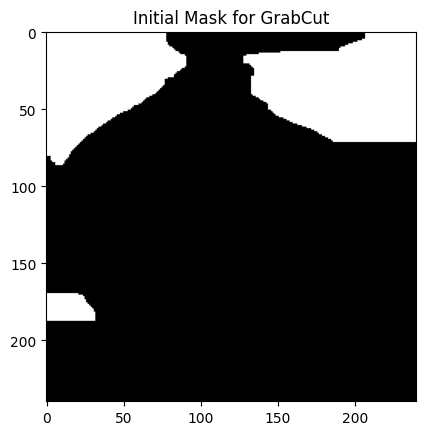

In [ ]:
plt.imshow(clean_mask, cmap='gray')
plt.title("Initial Mask for GrabCut")
plt.show()

In [ ]:
def show_saliency_overlays(source_img, orig_sal, warped_sal, fused_sal):
    def overlay(sal): return cv2.addWeighted(source_img, 0.6, cv2.cvtColor((sal*255).astype(np.uint8), cv2.COLOR_GRAY2RGB), 0.4, 0)

    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.title("Original Saliency")
    plt.imshow(overlay(orig_sal))

    plt.subplot(1,3,2)
    plt.title("Warped Saliency")
    plt.imshow(overlay(warped_sal))

    plt.subplot(1,3,3)
    plt.title("Fused (Geo Mean)")
    plt.imshow(overlay(fused_sal))
    plt.show()

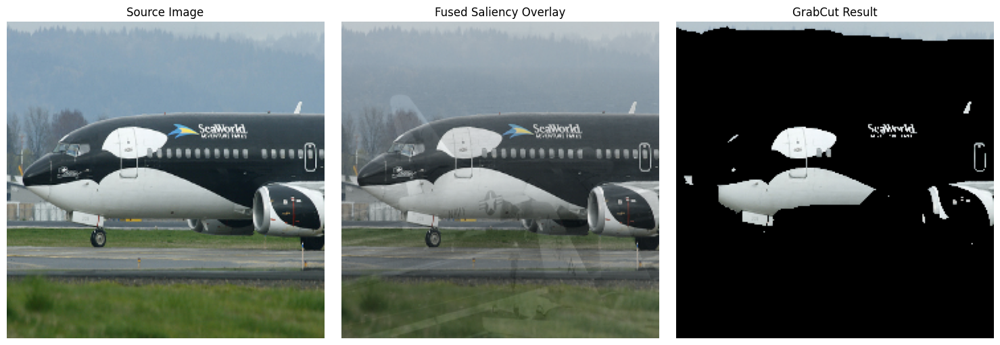

In [ ]:
import cv2
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# === Load and preprocess ===
def load_and_preprocess(img_path):
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, (240, 240))
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img_resized).unsqueeze(0).to(device)
    return img_tensor, img_resized

# === Image Paths ===
img1_path = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane/ILSVRC2012_val_00001390.jpg'
img2_path = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane/ILSVRC2012_val_00004089.jpg'

img1_tensor, img1_resized = load_and_preprocess(img1_path)
img2_tensor, img2_resized = load_and_preprocess(img2_path)

# === DGCNet (assumes already loaded as `dgc_model`) ===
dgc_model.eval()
dgc_model.to(device)

# === Run model to get warp ===
with torch.no_grad():
    warped_output, matchability = dgc_model(img1_tensor, img2_tensor)

final_warp = warped_output[-1]  # [1, 2, H, W]
final_warp_np = final_warp.squeeze().permute(1, 2, 0).cpu().numpy()

# === Simulated saliency maps (Replace with real ones) ===
# These are placeholders. Replace with actual saliency output.
original_saliency = cv2.cvtColor(img1_resized, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0
warped_saliency = cv2.cvtColor(img2_resized, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0

# === Normalize both saliencies ===
original_saliency = np.clip(original_saliency, 0, 1)
warped_saliency = np.clip(warped_saliency, 0, 1)

# === Fused saliency strategies ===
geo_mean = np.sqrt(original_saliency * warped_saliency)
mean_fusion = (original_saliency + warped_saliency) / 2
max_fusion = np.maximum(original_saliency, warped_saliency)

# === Morphological Binary Threshold ===
def process_mask(sal_map, threshold=0.85):
    th = np.percentile(sal_map, threshold * 100)
    binary = (sal_map > th).astype(np.uint8)
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, np.ones((5, 5), np.uint8), iterations=2)
    return binary

# === GrabCut using fused map ===
def grabcut_from_saliency(image, saliency):
    mask = np.zeros(image.shape[:2], np.uint8)
    sal_norm = (saliency * 255).astype(np.uint8)
    mask[sal_norm > 200] = cv2.GC_FGD
    mask[sal_norm < 30] = cv2.GC_BGD
    mask[(sal_norm >= 30) & (sal_norm <= 200)] = cv2.GC_PR_BGD

    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)

    try:
        cv2.grabCut(image, mask, None, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_MASK)
        mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype(np.uint8)
        segmented = image * mask2[:, :, np.newaxis]
    except:
        print("GrabCut failed — fallback to binary mask")
        mask2 = process_mask(saliency)
        segmented = image * mask2[:, :, np.newaxis]

    return segmented

# === Choose one fused saliency to try ===
fused_sal = geo_mean  # or mean_fusion, max_fusion

# === Apply GrabCut ===
grabcut_result = grabcut_from_saliency(img1_resized, fused_sal)

# === Overlay function ===
def overlay_saliency(image, saliency):
    sal_uint8 = (saliency * 255).astype(np.uint8)
    return cv2.addWeighted(image, 0.6, cv2.cvtColor(sal_uint8, cv2.COLOR_GRAY2RGB), 0.4, 0)

# === Show all results ===
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.title("Source Image")
plt.imshow(img1_resized)
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Fused Saliency Overlay")
plt.imshow(overlay_saliency(img1_resized, fused_sal))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("GrabCut Result")
plt.imshow(grabcut_result)
plt.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms

# ========== Setup ==========
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Folder of images
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
image_list = sorted([os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.jpg')])

# Choose fixed source image
source_path = image_list[0]

# Load DGCNet model
dgc_model.eval()
dgc_model.to(device)

# ========== Helpers ==========

def load_and_preprocess(img_path):
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, (240, 240))
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img_resized).unsqueeze(0).to(device)
    return img_tensor, img_resized

def dummy_saliency(img_rgb):
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY).astype(np.float32) / 255.0
    return np.clip(gray, 0, 1)

def fuse_saliency(orig_sal, warped_sal):
    return np.sqrt(orig_sal * warped_sal)  # Geometric mean fusion

def grabcut_from_saliency(image, saliency):
    mask = np.zeros(image.shape[:2], np.uint8)
    sal_norm = (saliency * 255).astype(np.uint8)
    mask[sal_norm > 200] = cv2.GC_FGD
    mask[sal_norm < 30] = cv2.GC_BGD
    mask[(sal_norm >= 30) & (sal_norm <= 200)] = cv2.GC_PR_BGD

    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)
    try:
        cv2.grabCut(image, mask, None, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_MASK)
        mask2 = np.where((mask == 2) | (mask == 0), 0, 1).astype(np.uint8)
        result = image * mask2[:, :, np.newaxis]
    except:
        result = image  # Fallback
    return result

def overlay_saliency(image, saliency):
    sal_uint8 = (saliency * 255).astype(np.uint8)
    return cv2.addWeighted(image, 0.6, cv2.cvtColor(sal_uint8, cv2.COLOR_GRAY2RGB), 0.4, 0)

# ========== Load Source ==========
src_tensor, src_img = load_and_preprocess(source_path)
src_saliency = dummy_saliency(src_img)

# ========== Iterate Over Targets ==========
for target_path in image_list[1:]:
    print(f"Processing target: {os.path.basename(target_path)}")

    tgt_tensor, tgt_img = load_and_preprocess(target_path)
    tgt_saliency = dummy_saliency(tgt_img)

    # Warp from source → target
    with torch.no_grad():
        warped_output, _ = dgc_model(src_tensor, tgt_tensor)

    flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()

    # Just using target saliency directly for demonstration
    warped_sal = tgt_saliency  # Replace with warped saliency via flow if needed

    # Fuse saliency
    fused = fuse_saliency(src_saliency, warped_sal)

    # Apply grabcut
    grabcut_result = grabcut_from_saliency(src_img, fused)

    # ========== Show/Save ==========
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    axs[0].imshow(src_img)
    axs[0].set_title("Source Image")
    axs[1].imshow(tgt_img)
    axs[1].set_title("Target Image")
    axs[2].imshow(overlay_saliency(src_img, fused))
    axs[2].set_title("Fused Overlay")
    axs[3].imshow(grabcut_result)
    axs[3].set_title("GrabCut Result")
    for ax in axs:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
from scipy.ndimage import map_coordinates

# ----------- Config -----------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
image_list = sorted([f for f in os.listdir(image_dir) if f.endswith('.jpg')])
source_path = os.path.join(image_dir, image_list[0])  # Fixed source
resize_dim = (240, 240)

# ----------- DGCNet Model -----------
dgc_model = dgc_model.to(device)
dgc_model.eval()

# ----------- Image + Preprocess -----------
def load_img_and_tensor(path):
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, resize_dim)
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img_resized).unsqueeze(0).to(device)
    return img_resized, img_tensor

# ----------- Dummy Saliency (Otsu) -----------
def generate_otsu_saliency(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, mask = cv2.threshold(gray, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return mask.astype(np.float32)

# ----------- Warping Utility -----------
def warp_saliency(saliency_map, flow):
    H, W = saliency_map.shape
    grid_x, grid_y = np.meshgrid(np.arange(W), np.arange(H))
    map_x = (grid_x + flow[..., 0]).clip(0, W - 1)
    map_y = (grid_y + flow[..., 1]).clip(0, H - 1)
    warped = map_coordinates(saliency_map, [map_y.ravel(), map_x.ravel()], order=1).reshape(H, W)
    return warped

# ----------- Fuse (Geometric Mean) -----------
def fuse_saliency(sal1, sal2):
    return np.sqrt(np.clip(sal1 * sal2, 0, 1))

# ----------- Load Source -----------
src_img, src_tensor = load_img_and_tensor(source_path)
src_saliency = generate_otsu_saliency(src_img)

# ----------- Iterate Over Targets -----------
for tgt_name in image_list[1:]:
    tgt_path = os.path.join(image_dir, tgt_name)
    tgt_img, tgt_tensor = load_img_and_tensor(tgt_path)
    tgt_saliency = generate_otsu_saliency(tgt_img)

    # ---- Run DGCNet ----
    with torch.no_grad():
        warped_output, _ = dgc_model(src_tensor, tgt_tensor)
    flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()

    # ---- Warp target saliency ----
    warped_saliency = warp_saliency(tgt_saliency, flow)

    # ---- Fuse ----
    fused = fuse_saliency(src_saliency, warped_saliency)

    # ---- Visualize ----
    flow_mag = np.linalg.norm(flow, axis=2)

    plt.figure(figsize=(16, 4))
    plt.subplot(1, 4, 1)
    plt.imshow(src_img)
    plt.title("Source Image")
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.imshow(tgt_saliency, cmap='gray')
    plt.title("Target Saliency")
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.imshow(flow_mag, cmap='jet')
    plt.title("Warped Flow Magnitude")
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.imshow(fused, cmap='gray')
    plt.title("Fused Saliency (Geo Mean)")
    plt.axis('off')

    plt.suptitle(f'Fusion with target: {tgt_name}')
    plt.tight_layout()
    plt.show()


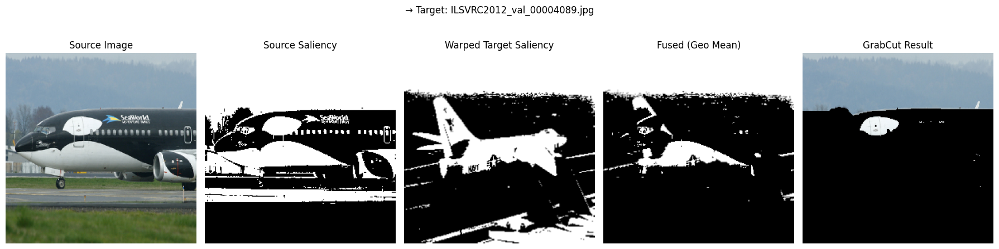

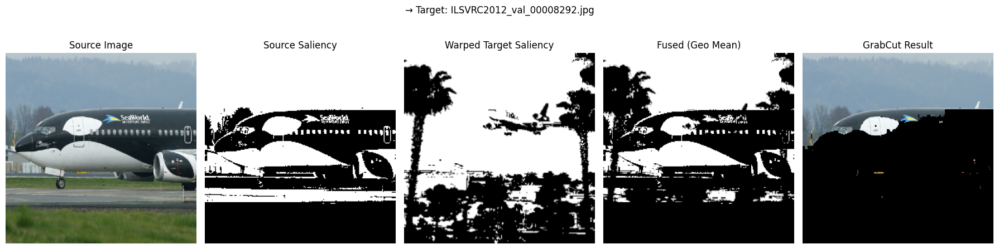

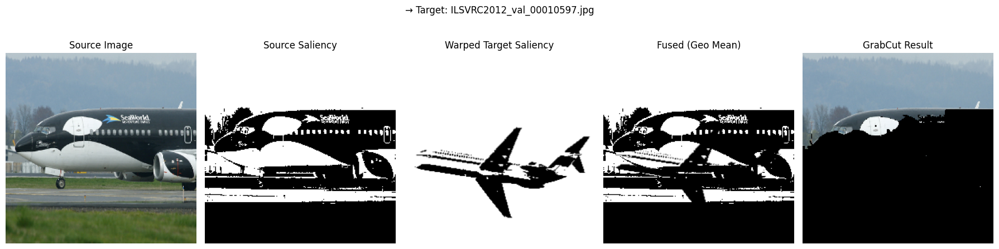

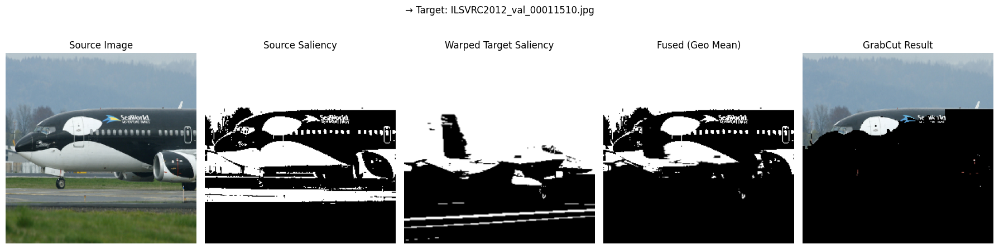

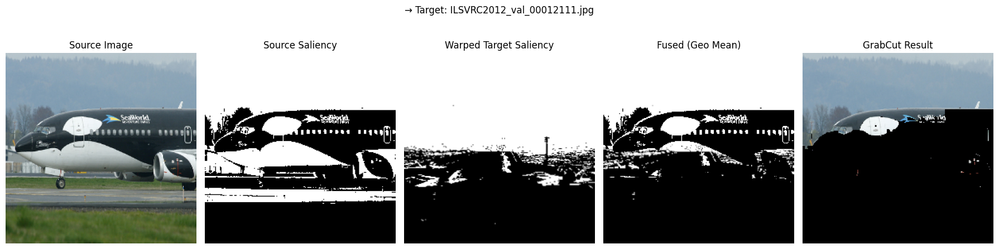

...

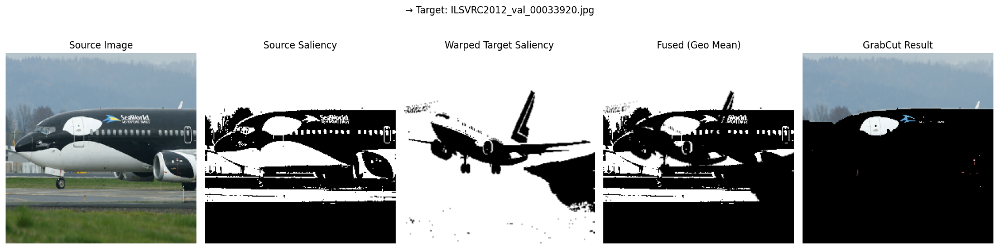

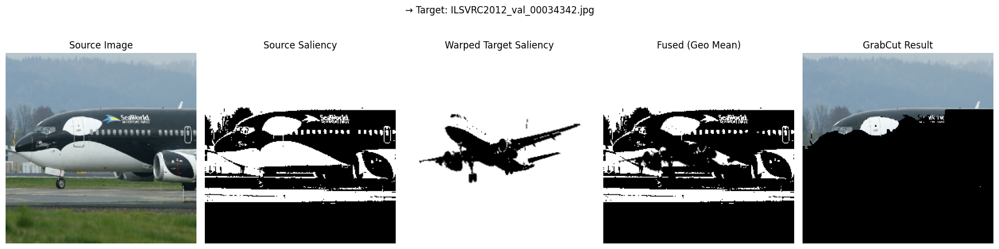

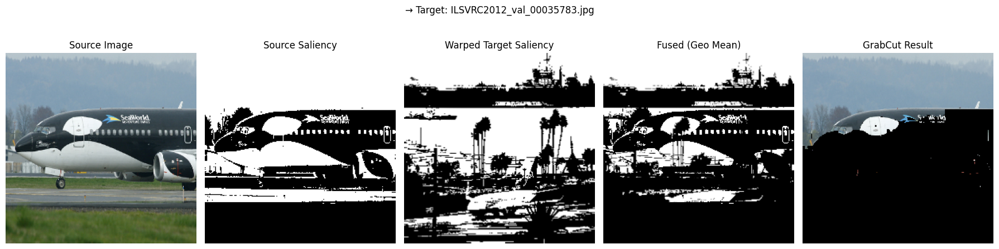

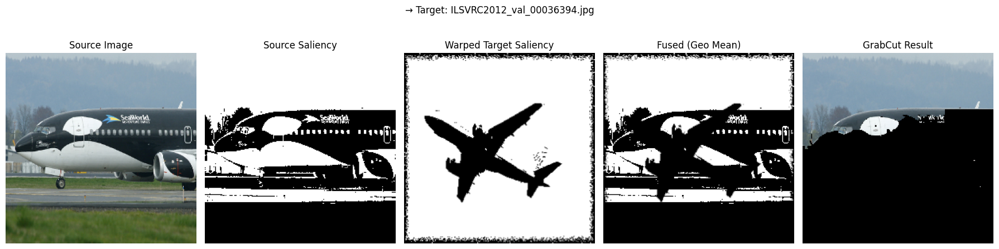

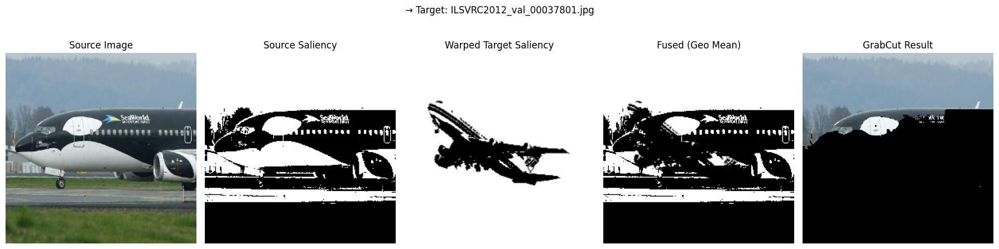

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from torchvision import transforms
from scipy.ndimage import map_coordinates

# ----------- Setup -----------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
image_list = sorted([f for f in os.listdir(image_dir) if f.endswith('.jpg')])
source_path = os.path.join(image_dir, image_list[0])  # Fixed source image
resize_dim = (240, 240)

# ----------- DGCNet -----------
dgc_model = dgc_model.to(device)
dgc_model.eval()

# ----------- Image Preprocessing -----------
def load_img_and_tensor(path):
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, resize_dim)
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img_resized).unsqueeze(0).to(device)
    return img_rgb, img_resized, img_tensor

# ----------- Otsu Saliency Map -----------
def generate_otsu_saliency(image_rgb):
    gray = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2GRAY)
    _, mask = cv2.threshold(gray, 0, 1, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    return mask.astype(np.float32)

# ----------- Warp Saliency -----------
def warp_saliency(saliency_map, flow):
    H, W = saliency_map.shape
    grid_x, grid_y = np.meshgrid(np.arange(W), np.arange(H))
    map_x = (grid_x + flow[..., 0]).clip(0, W - 1)
    map_y = (grid_y + flow[..., 1]).clip(0, H - 1)
    warped = map_coordinates(saliency_map, [map_y.ravel(), map_x.ravel()], order=1).reshape(H, W)
    return warped

# ----------- Fuse with Geometric Mean -----------
def fuse_saliency(sal1, sal2):
    return np.sqrt(np.clip(sal1 * sal2, 0, 1))

# ----------- Apply GrabCut using Fused Map -----------
def apply_grabcut(image, fused_saliency):
    sal_bin = (fused_saliency > 0.5).astype(np.uint8)
    mask = np.where(sal_bin == 1, cv2.GC_PR_FGD, cv2.GC_PR_BGD).astype(np.uint8)

    bg_model = np.zeros((1, 65), np.float64)
    fg_model = np.zeros((1, 65), np.float64)

    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    mask_gc = mask.copy()
    cv2.grabCut(image_bgr, mask_gc, None, bg_model, fg_model, 5, cv2.GC_INIT_WITH_MASK)
    final_mask = np.where((mask_gc == cv2.GC_FGD) | (mask_gc == cv2.GC_PR_FGD), 1, 0).astype(np.uint8)
    result = image.copy()
    result[final_mask == 0] = [0, 0, 0]
    return result

# ----------- Load Source -----------
src_rgb, src_resized, src_tensor = load_img_and_tensor(source_path)
src_saliency = generate_otsu_saliency(src_resized)

# ----------- Iterate Over Target Images -----------
for tgt_name in image_list[1:]:
    tgt_path = os.path.join(image_dir, tgt_name)
    tgt_rgb, tgt_resized, tgt_tensor = load_img_and_tensor(tgt_path)
    tgt_saliency = generate_otsu_saliency(tgt_resized)

    # --- DGCNet Warping ---
    with torch.no_grad():
        warped_output, _ = dgc_model(src_tensor, tgt_tensor)
    flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()

    # --- Warp + Fuse ---
    warped_sal = warp_saliency(tgt_saliency, flow)
    fused = fuse_saliency(src_saliency, warped_sal)

    # --- GrabCut ---
    result = apply_grabcut(src_resized, fused)

    # --- Flow Magnitude (for visual)
    flow_mag = np.linalg.norm(flow, axis=2)

    # --- Plot ---
    plt.figure(figsize=(18, 5))
    plt.subplot(1, 5, 1)
    plt.imshow(src_resized)
    plt.title("Source Image")
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.imshow(src_saliency, cmap='gray')
    plt.title("Source Saliency")
    plt.axis('off')

    plt.subplot(1, 5, 3)
    plt.imshow(warped_sal, cmap='gray')
    plt.title("Warped Target Saliency")
    plt.axis('off')

    plt.subplot(1, 5, 4)
    plt.imshow(fused, cmap='gray')
    plt.title("Fused (Geo Mean)")
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.imshow(result)
    plt.title("GrabCut Result")
    plt.axis('off')

    plt.suptitle(f'→ Target: {tgt_name}')
    plt.tight_layout()
    plt.show()

In [ ]:
import os
import cv2
import torch
import numpy as np
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from glob import glob

# ---- Setup ----
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
saliency_dir = '/content/AMC-grounding/cosod_saliency_maps/airplane'
output_dir = '/content/AMC-grounding/results/airplane'
os.makedirs(output_dir, exist_ok=True)

# ---- Load DGCNet ----
dgc_model = dgc_model.to(device)
dgc_model.eval()

# ---- Utility functions ----
def load_image_and_tensor(path):
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, (240, 240))
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    tensor = transform(img_resized).unsqueeze(0).to(device)
    return tensor, img_resized

def load_saliency(path, shape):
    sal = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    sal = cv2.resize(sal, shape[::-1])  # shape: (W, H)
    sal = sal / 255.0
    return sal

def warp_saliency_with_flow(saliency, flow):
    h, w = saliency.shape
    flow_map = np.stack(np.meshgrid(np.arange(w), np.arange(h)), axis=-1).astype(np.float32)
    warped_coords = flow_map + flow
    warped = cv2.remap(saliency.astype(np.float32), warped_coords[..., 0], warped_coords[..., 1], cv2.INTER_LINEAR)
    return np.clip(warped, 0, 1)

def fuse_saliency(sal1, sal2):
    return np.sqrt(sal1 * sal2)

def apply_grabcut(image, saliency):
    mask = np.where(saliency > 0.5, cv2.GC_PR_FGD, cv2.GC_BGD).astype('uint8')
    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)
    try:
        cv2.grabCut(image, mask, None, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_MASK)
        result_mask = np.where((mask == cv2.GC_FGD) | (mask == cv2.GC_PR_FGD), 255, 0).astype('uint8')
        return result_mask
    except:
        return np.zeros_like(saliency, dtype='uint8')

# ---- Source Image ----
source_img_path = sorted(glob(os.path.join(image_dir, '*.jpg')))[0]  # Use first image as source
source_tensor, source_resized = load_image_and_tensor(source_img_path)
source_filename = os.path.basename(source_img_path)
source_sal_path = os.path.join(saliency_dir, source_filename.replace('.jpg', '_saliency.png'))
source_sal = load_saliency(source_sal_path, source_resized.shape[:2])

# ---- Process each target image ----
all_images = sorted(glob(os.path.join(image_dir, '*.jpg')))
for target_img_path in all_images:
    if target_img_path == source_img_path:
        continue

    target_tensor, target_resized = load_image_and_tensor(target_img_path)
    target_filename = os.path.basename(target_img_path)
    target_sal_path = os.path.join(saliency_dir, target_filename.replace('.jpg', '_saliency.png'))
    target_sal = load_saliency(target_sal_path, target_resized.shape[:2])

    with torch.no_grad():
        warped_output, _ = dgc_model(source_tensor, target_tensor)
        flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()
        flow = cv2.resize(flow, (240, 240))

    # --- Warp target saliency map to source ---
    warped_sal = warp_saliency_with_flow(target_sal, flow)

    # --- Fuse with original saliency (geometric mean) ---
    fused_sal = fuse_saliency(source_sal, warped_sal)

    # --- GrabCut on source and target ---
    grabcut_source = apply_grabcut(source_resized, fused_sal)
    grabcut_target = apply_grabcut(target_resized, target_sal)

    # --- Save result ---
    combined = np.hstack([
        source_resized,
        cv2.cvtColor((fused_sal * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB),
        cv2.cvtColor(grabcut_source, cv2.COLOR_GRAY2RGB),
        target_resized,
        cv2.cvtColor(grabcut_target, cv2.COLOR_GRAY2RGB)
    ])
    save_path = os.path.join(output_dir, f'{os.path.splitext(target_filename)[0]}_result.png')
    cv2.imwrite(save_path, cv2.cvtColor(combined, cv2.COLOR_RGB2BGR))
    print(f"Saved: {save_path}")

Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00004089_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00008292_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00010597_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00011510_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00012111_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00012263_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00012386_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00014425_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00015498_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00016995_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00019179_result.png
Saved: /content/AMC-grounding/results/airplane/ILSVRC2012_val_00019677_result.png
Saved: /content/

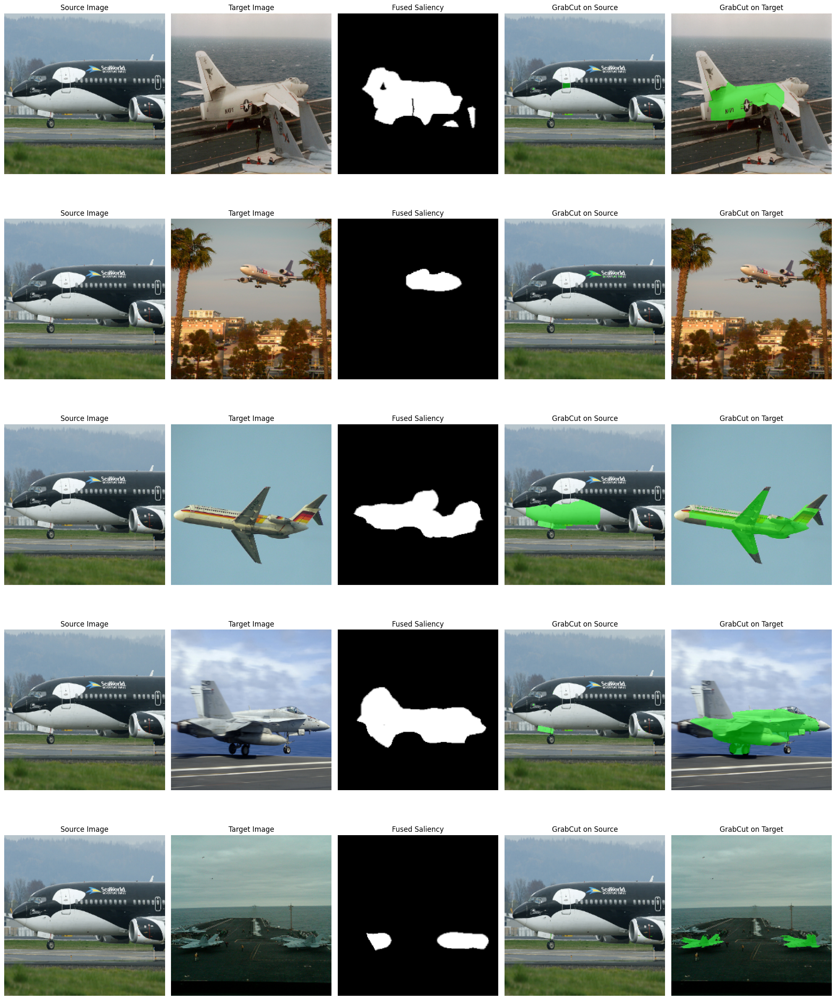

In [ ]:
import matplotlib.pyplot as plt

def overlay_mask_on_image(image, mask, alpha=0.5, color=(0, 255, 0)):
    overlay = image.copy()
    mask_bool = mask.astype(bool)
    overlay[mask_bool] = cv2.addWeighted(image[mask_bool], 1 - alpha, np.full_like(image[mask_bool], color), alpha, 0)
    return overlay

# Collect results for plotting
visual_results = []
image_counter = 0

all_images = sorted(glob(os.path.join(image_dir, '*.jpg')))
for target_img_path in all_images:
    if target_img_path == source_img_path:
        continue

    target_tensor, target_resized = load_image_and_tensor(target_img_path)
    target_filename = os.path.basename(target_img_path)
    target_sal_path = os.path.join(saliency_dir, target_filename.replace('.jpg', '_saliency.png'))
    target_sal = load_saliency(target_sal_path, target_resized.shape[:2])

    with torch.no_grad():
        warped_output, _ = dgc_model(source_tensor, target_tensor)
        flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()
        flow = cv2.resize(flow, (240, 240))

    warped_sal = warp_saliency_with_flow(target_sal, flow)
    fused_sal = fuse_saliency(source_sal, warped_sal)

    grabcut_source = apply_grabcut(source_resized, fused_sal)
    grabcut_target = apply_grabcut(target_resized, target_sal)

    # Prepare overlays
    overlay_src = overlay_mask_on_image(source_resized, grabcut_source // 255)
    overlay_tgt = overlay_mask_on_image(target_resized, grabcut_target // 255)

    visual_results.append({
        "src": source_resized,
        "tgt": target_resized,
        "fused_sal": fused_sal,
        "overlay_src": overlay_src,
        "overlay_tgt": overlay_tgt
    })

    image_counter += 1
    if image_counter >= 5:
        break

# Plot
fig, axs = plt.subplots(len(visual_results), 5, figsize=(20, 5 * len(visual_results)))
for i, res in enumerate(visual_results):
    axs[i, 0].imshow(res["src"])
    axs[i, 0].set_title("Source Image")
    axs[i, 1].imshow(res["tgt"])
    axs[i, 1].set_title("Target Image")
    axs[i, 2].imshow(res["fused_sal"], cmap='gray')
    axs[i, 2].set_title("Fused Saliency")
    axs[i, 3].imshow(res["overlay_src"])
    axs[i, 3].set_title("GrabCut on Source")
    axs[i, 4].imshow(res["overlay_tgt"])
    axs[i, 4].set_title("GrabCut on Target")

for ax in axs.flat:
    ax.axis('off')
plt.tight_layout()
plt.show()

In [ ]:
import os
import cv2
import torch
import numpy as np
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from glob import glob

# ---- Setup ----
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_dir = '/content/AMC-grounding/cosod/CoSOD3k/Image/airplane'
saliency_dir = '/content/AMC-grounding/cosod_saliency_maps/airplane'
output_dir = '/content/AMC-grounding/results/airplane_visualization'
os.makedirs(output_dir, exist_ok=True)

# ---- Load DGCNet ----
dgc_model = dgc_model.to(device)
dgc_model.eval()

# ---- Utility functions ----
def load_image_and_tensor(path):
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_resized = cv2.resize(img_rgb, (240, 240))
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    tensor = transform(img_resized).unsqueeze(0).to(device)
    return tensor, img_resized

def load_saliency(path, shape):
    sal = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    sal = cv2.resize(sal, shape[::-1])  # shape: (H, W)
    sal = sal / 255.0
    return sal

def warp_saliency_with_flow(saliency, flow):
    h, w = saliency.shape
    grid_x, grid_y = np.meshgrid(np.arange(w), np.arange(h))
    map_x = (grid_x + flow[..., 0]).astype(np.float32)
    map_y = (grid_y + flow[..., 1]).astype(np.float32)
    warped = cv2.remap(saliency.astype(np.float32), map_x, map_y, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
    return np.clip(warped, 0, 1)

def fuse_saliency(sal1, sal2):
    return np.sqrt(sal1 * sal2)

def apply_grabcut(image, saliency):
    mask = np.where(saliency > 0.5, cv2.GC_PR_FGD, cv2.GC_BGD).astype('uint8')
    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)
    try:
        cv2.grabCut(image, mask, None, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_MASK)
        result_mask = np.where((mask == cv2.GC_FGD) | (mask == cv2.GC_PR_FGD), 255, 0).astype('uint8')
        return result_mask
    except:
        return np.zeros_like(saliency, dtype='uint8')

# ---- Source image ----
source_img_path = sorted(glob(os.path.join(image_dir, '*.jpg')))[0]
source_tensor, source_resized = load_image_and_tensor(source_img_path)
source_filename = os.path.basename(source_img_path)
source_sal_path = os.path.join(saliency_dir, source_filename.replace('.jpg', '_saliency.png'))
source_sal = load_saliency(source_sal_path, source_resized.shape[:2])

# ---- Process each target image ----
all_images = sorted(glob(os.path.join(image_dir, '*.jpg')))
for target_img_path in all_images:
    if target_img_path == source_img_path:
        continue

    target_tensor, target_resized = load_image_and_tensor(target_img_path)
    target_filename = os.path.basename(target_img_path)
    target_sal_path = os.path.join(saliency_dir, target_filename.replace('.jpg', '_saliency.png'))
    target_sal = load_saliency(target_sal_path, target_resized.shape[:2])

    with torch.no_grad():
        warped_output, _ = dgc_model(source_tensor, target_tensor)
        flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()  # [H, W, 2]

    # --- Warp target saliency map to source space ---
    warped_sal = warp_saliency_with_flow(target_sal, flow)

    # --- Fuse saliency maps ---
    fused_sal = fuse_saliency(source_sal, warped_sal)

    # --- Apply GrabCut segmentation ---
    grabcut_mask = apply_grabcut(source_resized, fused_sal)

    # --- Visualize results side by side like paper figure ---
    def to_gray_rgb(arr):
        return cv2.cvtColor((arr * 255).astype(np.uint8), cv2.COLOR_GRAY2RGB)

    visualization_row = np.hstack([
        source_resized,
        target_resized,
        to_gray_rgb(source_sal),
        to_gray_rgb(target_sal),
        to_gray_rgb(warped_sal),
        to_gray_rgb(fused_sal),
        cv2.cvtColor(grabcut_mask, cv2.COLOR_GRAY2RGB)
    ])

    save_path = os.path.join(output_dir, f"{os.path.splitext(target_filename)[0]}_visual.png")
    cv2.imwrite(save_path, cv2.cvtColor(visualization_row, cv2.COLOR_RGB2BGR))
    print(f"Saved: {save_path}")

Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00004089_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00008292_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00010597_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00011510_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00012111_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00012263_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00012386_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00014425_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00015498_visual.png
Saved: /content/AMC-grounding/results/airplane_visualization/ILSVRC2012_val_00016995_visual.png
Saved: /content/AMC-grounding/results/ai

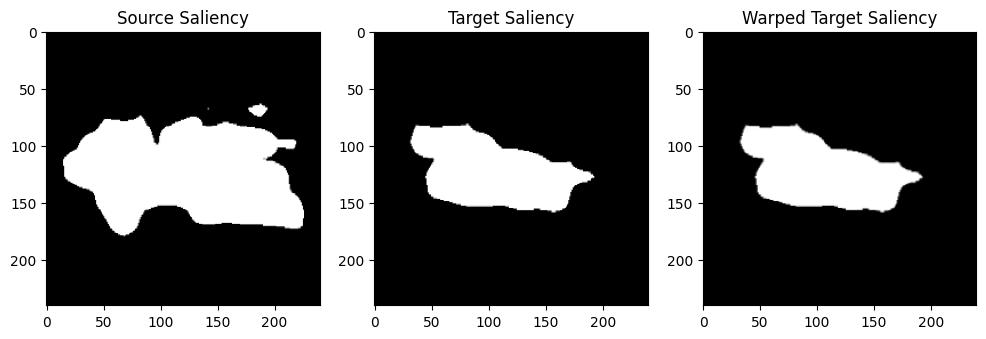

In [ ]:
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.title("Source Saliency")
plt.imshow(source_sal, cmap='gray')

plt.subplot(1, 3, 2)
plt.title("Target Saliency")
plt.imshow(target_sal, cmap='gray')

plt.subplot(1, 3, 3)
plt.title("Warped Target Saliency")
plt.imshow(warped_sal, cmap='gray')
plt.show()

In [ ]:
import cv2
import numpy as np

def warp_saliency(source_saliency, correspondence_map):
    h, w = correspondence_map.shape[:2]
    flow_map = correspondence_map.astype(np.float32)

    # Generate grid of target image pixels
    x, y = np.meshgrid(np.arange(w), np.arange(h))
    coords = np.stack((x, y), axis=-1).astype(np.float32)

    # New coords = original + flow
    new_coords = coords + flow_map

    # Warp saliency using remap
    warped_saliency = cv2.remap(source_saliency,
                                new_coords[..., 0], new_coords[..., 1],
                                interpolation=cv2.INTER_LINEAR,
                                borderMode=cv2.BORDER_CONSTANT,
                                borderValue=0)
    return warped_saliency

In [ ]:
def geometric_mean_mask(warped_saliency, target_saliency):
    warped = warped_saliency.astype(np.float32) / 255.0
    target = target_saliency.astype(np.float32) / 255.0
    geom_mean = np.sqrt(warped * target)
    geom_mean = (geom_mean * 255).astype(np.uint8)
    return geom_mean

In [ ]:
def apply_grabcut_with_mask(target_image, geom_mask):
    mask = np.zeros(target_image.shape[:2], np.uint8)

    # Threshold to define probable foreground
    _, fg_mask = cv2.threshold(geom_mask, 25, 255, cv2.THRESH_BINARY)

    mask[fg_mask == 255] = cv2.GC_PR_FGD  # Probable foreground
    mask[fg_mask == 0] = cv2.GC_BGD       # Background

    bgdModel = np.zeros((1, 65), np.float64)
    fgdModel = np.zeros((1, 65), np.float64)

    cv2.grabCut(target_image, mask, None, bgdModel, fgdModel, 5, cv2.GC_INIT_WITH_MASK)

    # Final mask: 1 and 3 are foreground
    output_mask = np.where((mask == cv2.GC_FGD) | (mask == cv2.GC_PR_FGD), 255, 0).astype(np.uint8)
    result = cv2.bitwise_and(target_image, target_image, mask=output_mask)
    return result, output_mask

⚠️ Skipping GrabCut: insufficient foreground/background pixels
⚠️ Empty GrabCut mask — skipping overlay.
⚠️ Empty GrabCut mask — skipping overlay.
⚠️ Skipping GrabCut: insufficient foreground/background pixels
⚠️ Empty GrabCut mask — skipping overlay.
⚠️ Skipping GrabCut: insufficient foreground/background pixels
⚠️ Empty GrabCut mask — skipping overlay.


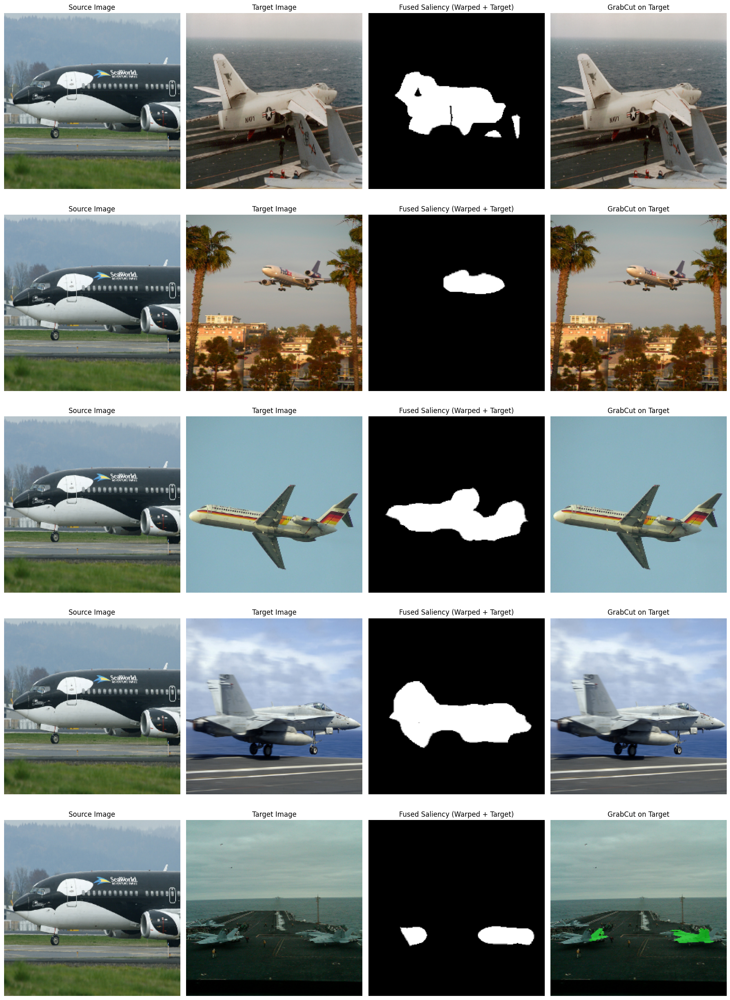

In [ ]:
import os
import cv2
import torch
import numpy as np
import matplotlib.pyplot as plt
from glob import glob

# ===== Utility Functions =====

def overlay_mask_on_image(image, mask, alpha=0.5, color=(0, 255, 0)):
    overlay = image.copy()
    mask_bool = mask.astype(bool)
    overlay[mask_bool] = cv2.addWeighted(image[mask_bool], 1 - alpha, np.full_like(image[mask_bool], color), alpha, 0)
    return overlay

def warp_saliency_with_flow(saliency, flow):
    h, w = saliency.shape
    grid_x, grid_y = np.meshgrid(np.arange(w), np.arange(h))
    map_x = (grid_x + flow[..., 0]).astype(np.float32)
    map_y = (grid_y + flow[..., 1]).astype(np.float32)
    return cv2.remap(saliency, map_x, map_y, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT)

def fuse_saliency(warped_saliency, target_saliency):
    warped = cv2.normalize(warped_saliency.astype(np.float32), None, 0, 1, cv2.NORM_MINMAX)
    target = cv2.normalize(target_saliency.astype(np.float32), None, 0, 1, cv2.NORM_MINMAX)
    geom_mean = np.sqrt(warped * target)
    return (geom_mean * 255).astype(np.uint8)


"""
def fuse_saliency(warped_saliency, target_saliency):
    warped = warped_saliency.astype(np.float32) / 255.0
    target = target_saliency.astype(np.float32) / 255.0
    geom_mean = np.sqrt(warped * target)
    return (geom_mean * 255).astype(np.uint8)

def apply_grabcut(image, mask):
    mask = cv2.resize(mask, (image.shape[1], image.shape[0]))
    grabcut_mask = np.zeros(image.shape[:2], np.uint8)
    grabcut_mask[mask > 25] = cv2.GC_PR_FGD
    grabcut_mask[mask <= 25] = cv2.GC_BGD

    bg_model = np.zeros((1, 65), np.float64)
    fg_model = np.zeros((1, 65), np.float64)

    cv2.grabCut(image, grabcut_mask, None, bg_model, fg_model, 5, cv2.GC_INIT_WITH_MASK)
    final_mask = np.where((grabcut_mask == cv2.GC_FGD) | (grabcut_mask == cv2.GC_PR_FGD), 255, 0).astype('uint8')
    return final_mask"""

def apply_grabcut(image, mask):
    mask = cv2.resize(mask, (image.shape[1], image.shape[0]))

    # Adaptive thresholds
    thresh = np.percentile(mask, 90)
    grabcut_mask = np.zeros(image.shape[:2], np.uint8)
    grabcut_mask[mask > thresh] = cv2.GC_PR_FGD
    grabcut_mask[mask <= thresh // 2] = cv2.GC_BGD

    if not np.any(grabcut_mask == cv2.GC_PR_FGD) or not np.any(grabcut_mask == cv2.GC_BGD):
        print("⚠️ Skipping GrabCut: insufficient foreground/background pixels")
        return np.zeros(image.shape[:2], dtype=np.uint8)

    bg_model = np.zeros((1, 65), np.float64)
    fg_model = np.zeros((1, 65), np.float64)

    cv2.grabCut(image, grabcut_mask, None, bg_model, fg_model, 5, cv2.GC_INIT_WITH_MASK)
    final_mask = np.where((grabcut_mask == cv2.GC_FGD) | (grabcut_mask == cv2.GC_PR_FGD), 255, 0).astype('uint8')
    return final_mask

def load_saliency(path, shape):
    sal = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    return cv2.resize(sal, (shape[1], shape[0]))

# ===== Assume These Are Preloaded =====
# - source_img_path
# - source_sal (AMC+Otsu)
# - source_tensor, source_resized
# - dgc_model
# - image_dir
# - saliency_dir
# - load_image_and_tensor()

# ===== Main Loop =====

visual_results = []
image_counter = 0
all_images = sorted(glob(os.path.join(image_dir, '*.jpg')))

for target_img_path in all_images:
    if target_img_path == source_img_path:
        continue

    target_tensor, target_resized = load_image_and_tensor(target_img_path)
    target_filename = os.path.basename(target_img_path)
    target_sal_path = os.path.join(saliency_dir, target_filename.replace('.jpg', '_saliency.png'))
    target_sal = load_saliency(target_sal_path, (240, 240))

    with torch.no_grad():
        warped_output, _ = dgc_model(source_tensor, target_tensor)
        flow = warped_output[-1].squeeze().permute(1, 2, 0).cpu().numpy()
        flow = cv2.resize(flow, (240, 240))

    # Warp source saliency (AMC+Otsu)
    source_sal_resized = cv2.resize(source_sal, (240, 240))
    warped_sal = warp_saliency_with_flow(source_sal_resized, flow)

    # Fuse saliency maps
    fused_sal = fuse_saliency(warped_sal, target_sal)

    # Apply GrabCut on TARGET image only
    grabcut_mask = apply_grabcut(target_resized, fused_sal)
    if grabcut_mask is None or grabcut_mask.sum() == 0:
      print("⚠️ Empty GrabCut mask — skipping overlay.")
      overlay_target = target_resized.copy()
    else:
      overlay_target = overlay_mask_on_image(target_resized, grabcut_mask // 255)

    #overlay_target = overlay_mask_on_image(target_resized, grabcut_mask // 255)

    # Store for plotting
    visual_results.append({
        "src": source_resized,
        "tgt": target_resized,
        "fused_sal": fused_sal,
        "overlay_tgt": overlay_target
    })

    image_counter += 1
    if image_counter >= 5:
        break

# ===== Plotting =====

fig, axs = plt.subplots(len(visual_results), 4, figsize=(18, 5 * len(visual_results)))
for i, res in enumerate(visual_results):
    axs[i, 0].imshow(res["src"])
    axs[i, 0].set_title("Source Image")
    axs[i, 1].imshow(res["tgt"])
    axs[i, 1].set_title("Target Image")
    axs[i, 2].imshow(res["fused_sal"], cmap='gray')
    axs[i, 2].set_title("Fused Saliency (Warped + Target)")
    axs[i, 3].imshow(res["overlay_tgt"])
    axs[i, 3].set_title("GrabCut on Target")

for ax in axs.flat:
    ax.axis('off')
plt.tight_layout()
plt.show()